In [1]:
import os, sys, time, tqdm, importlib, pickle, json
import numpy as np
import pandas as pd
import pathlib
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import style
import matplotlib.patches as mpatches
import matplotlib.lines as mlines
from adjustText import adjust_text
import cmasher as cmr
import seaborn as sns
import scanpy as sc
import squidpy as sq
import scipy.stats as ss
import gseapy
import warnings
warnings.filterwarnings('ignore')
sys.path.append('../src')

style.use('seaborn-v0_8-white')
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)

In [8]:
## data and res dir
xenium_data_dir = '../data/Xenium_LN'
xenium_res_dir = '../results/Xenium_LN'
ref_data_dir = '../data/references'

In [115]:
## maps
with open('../data/maps/lymph_node_ct_name_map.json', 'r') as f:
    ct_name_dict = json.load(f)
with open('../data/maps/lymph_node_B_T_subct_name_map.json', 'r') as f:
    subct_name_dict = json.load(f)
with open('../data/maps/lymph_node_ct_cmap.json', 'r') as f:
    ct_cmap_dict = json.load(f)
with open('../data/maps/niche_cmap.json', 'r') as f:
    niche_cmap_dict = json.load(f)
cmap_niche = mpl.colors.LinearSegmentedColormap.from_list("cmap_niche", list(niche_cmap_dict.values()), N=len(niche_cmap_dict))
cmap_ct = mpl.colors.LinearSegmentedColormap.from_list("cmap_ct", list(ct_cmap_dict.values()), N=len(ct_cmap_dict))

In [4]:
## data after qc
crop1 = sc.read(f"{xenium_data_dir}/crop1.h5ad")
crop2 = sc.read(f"{xenium_data_dir}/crop2.h5ad")
print(f'Crop1: {len(crop1)} cells.')
print(f'Crop2: {len(crop2)} cells.')

Crop1: 80534 cells.
Crop2: 74851 cells.


In [5]:
all_cts = crop1.obs.cell_type.cat.categories
all_subcts = crop1.obs.sub_cell_type.cat.categories
print(f'{len(all_cts)} major cell types, {len(all_subcts)} sub cell types.')

13 major cell types, 30 sub cell types.


In [10]:
## ref
adata_file = f"{ref_data_dir}/sc_lymph_node.h5ad"
adata_ref = sc.read_h5ad(adata_file)

In [22]:
import niche_detection
importlib.reload(niche_detection)
from niche_detection import nichescope

In [186]:
import utils
importlib.reload(utils)
from utils import *

# T cell niche detection
Run NicheScope with T cell as target cell type on Xenium lymph node crop 1 and crop 2.

In [14]:
target_ct = 'T'
sigma = 20
cca_comp = 10
px = 0.6
pz = 0.5

In [13]:
t_subcts = [x for x in all_subcts if x.startswith('T') and 'naive' not in x]
print(f'T cell subtypes: {t_subcts}.')
adata_ref_t = adata_ref[adata_ref.obs.Subset.isin(t_subcts)].copy()
print(f'{adata_ref_t.shape[0]} T cells (all subtypes).')
gene_subset, n_per_gene = sc.pp.filter_genes(adata_ref_t, min_cells=150, inplace=False)
t_keep_genes_ref = adata_ref_t.var.SYMBOL[gene_subset].tolist()
print(f'Filtering genes with expression proportion < 0.01 in T cells (all subtypes) using reference scRNA-seq:\n{len(t_keep_genes_ref)} genes will be used in T cell niche detection.')

T cell subtypes: ['T_CD4+', 'T_CD4+_TfH_GC', 'T_CD8+_cytotoxic', 'T_TIM3+', 'T_TfR', 'T_Treg'].
14982 T cells (all subtypes).
Filtering genes with expression proportion < 0.01 in T cells (all subtypes) using reference scRNA-seq:
8213 genes will be used in T cell niche detection.


## Xenium crop 1

In [23]:
## run nichescope
meta1 = nichescope(crop1, 
                   target_ct, 
                   sigma=sigma, 
                   filter_genes=t_keep_genes_ref,
                   cov_test_null=True,
                   cca_comp=cca_comp, 
                   px=px, 
                   pz=pz)

[2025-07-28 11:45:50] [nichescope] [INFO] Dataset summary: 80534 cells, 4622 genes.
[2025-07-28 11:45:50] [nichescope] [INFO] 13 cell types: ['B', 'B_mem', 'B_plasma', 'DC', 'Endo', 'FDC', 'ILC', 'Macrophaeges', 'Myeloids', 'NK', 'Stromal', 'T', 'T_naive'].

[2025-07-28 11:45:56] [nichescope] [INFO] Computed neighborhood composition matrix N of shape (7129, 13).
[2025-07-28 11:45:58] [nichescope] [INFO] Nonneg CCA cors: [0.67  0.389 0.286 0.364 0.249 0.433 0.151 0.299 0.154 0.124]

[2025-07-28 11:45:58] [nichescope] [INFO] NicheScope on T: Finished in 7.7s.


In [26]:
## save result
with open(f'{xenium_res_dir}/crop1_{target_ct}.pkl', 'wb') as f:
    pickle.dump(meta1, f)

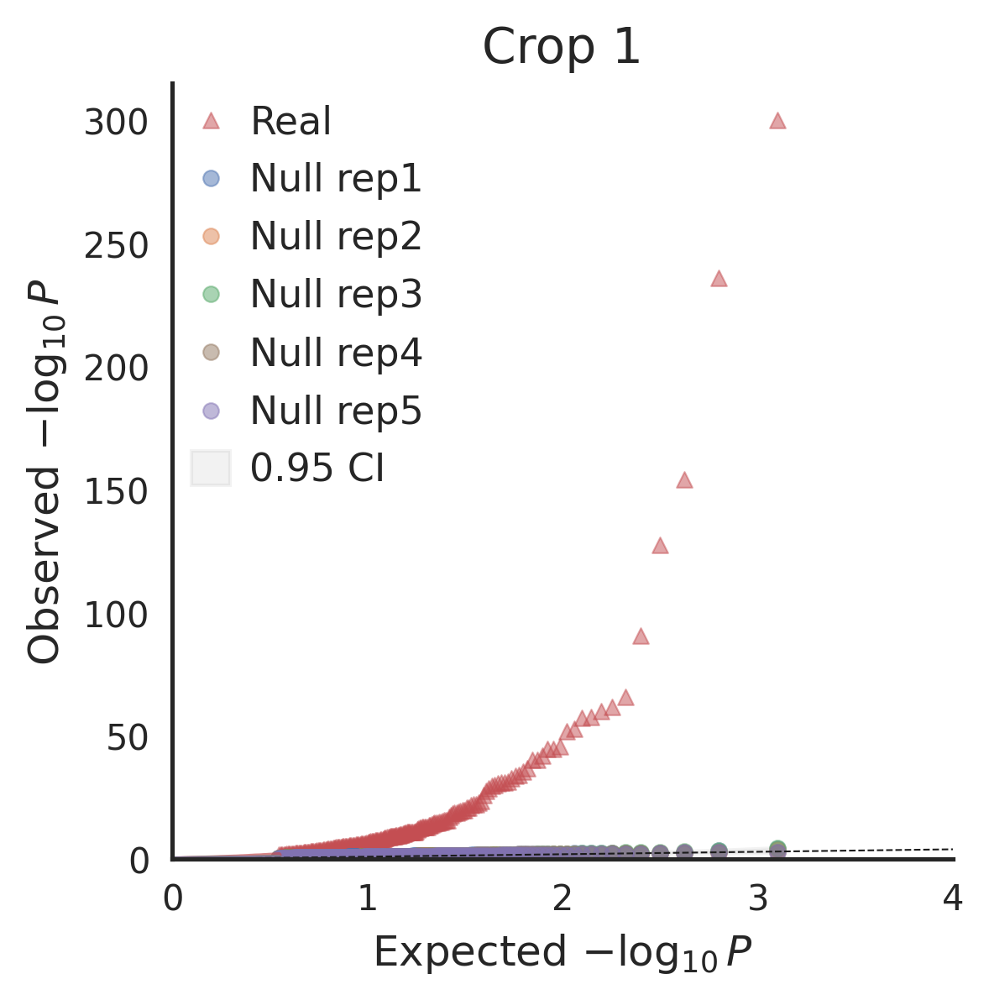

In [27]:
## cov test qqplot: real and null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=300)
qqplot(meta1['cov_real_null'], ['Real']+[f'Null rep{i}' for i in range(1,6)], ms=20,
       color=['C3', 'C0', 'C1', 'C2', 'C5', 'C4'], shape=['^','o','o','o','o','o'], 
       distribution='beta', ax=ax, title='Crop 1')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

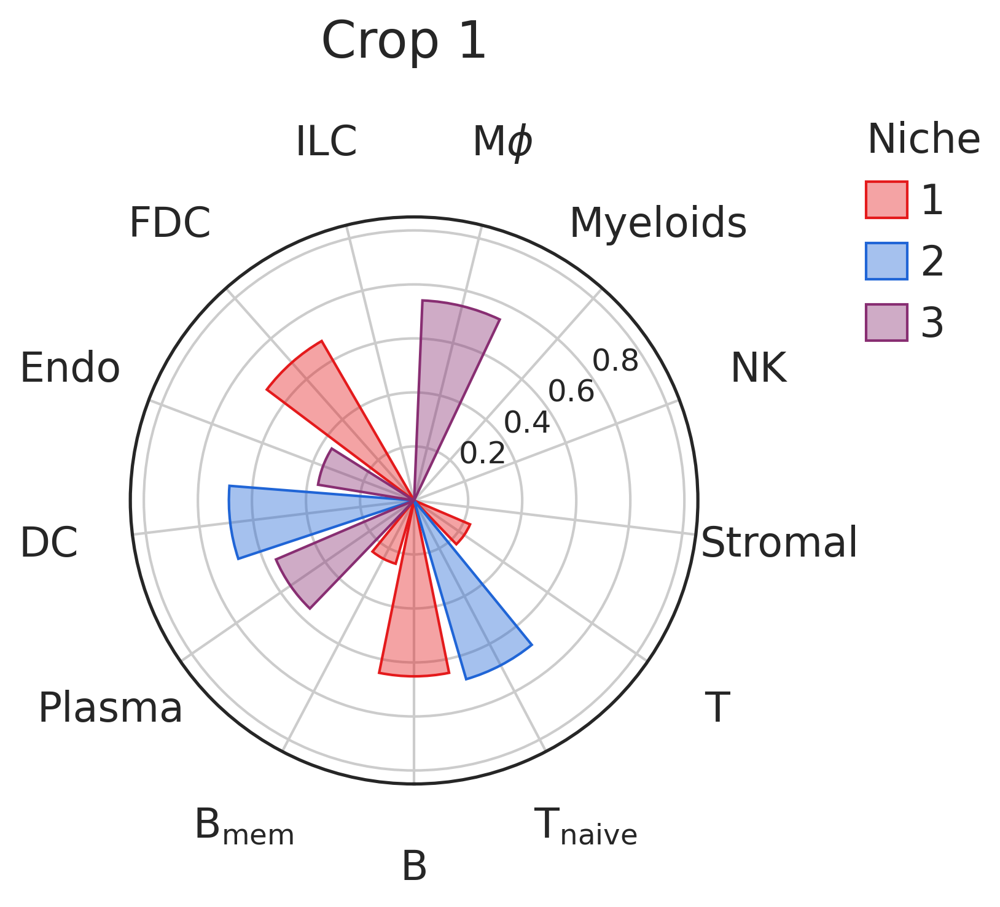

In [28]:
## representative cell niches: V radar plot
vdf1 = meta1['vdf']
comps1 = [1, 2, 3]
colors = [cmap_niche(i) for i in range(3)]
xticklabels = [ct_name_dict[x] for x in vdf1.index.tolist()]
draw_v_radar(vdf1, comps1, v_thres=0.2, colors=colors, alpha=0.8, width=0.4, offset=0.07, 
             xticklabels=xticklabels, rlabel_angle=235, figsize=(4,4), dpi=300, xtick_fs=16, xlabel_pad=20, 
             ylim=(0,1.05), yticks=[0.2,0.4,0.6,0.8,1.0], yticklabels=['0.2','0.4','0.6','0.8',''], ytick_fs=12, 
             leg_loc='upper right', leg_pos=(1.5,1.17), leg_ncol=1, leg_title='Niche', leg_fs=16, leg_title_fs=16, 
             title='Crop 1', title_fs=20, title_y=1.15)


## Xenium crop 2

In [29]:
## run nichescope
meta2 = nichescope(crop2, 
                   target_ct, 
                   sigma=sigma, 
                   filter_genes=t_keep_genes_ref,
                   cov_test_null=True,
                   cca_comp=cca_comp, 
                   px=px, 
                   pz=pz)

[2025-07-28 11:51:16] [nichescope] [INFO] Dataset summary: 74851 cells, 4623 genes.
[2025-07-28 11:51:16] [nichescope] [INFO] 13 cell types: ['B', 'B_mem', 'B_plasma', 'DC', 'Endo', 'FDC', 'ILC', 'Macrophaeges', 'Myeloids', 'NK', 'Stromal', 'T', 'T_naive'].

[2025-07-28 11:51:21] [nichescope] [INFO] Computed neighborhood composition matrix N of shape (5755, 13).
[2025-07-28 11:51:22] [nichescope] [INFO] Nonneg CCA cors: [0.664 0.306 0.378 0.464 0.275 0.19  0.    0.297 0.183 0.159]

[2025-07-28 11:51:22] [nichescope] [INFO] NicheScope on T: Finished in 6.0s.


In [30]:
## save result
with open(f'{xenium_res_dir}/crop2_{target_ct}.pkl', 'wb') as f:
    pickle.dump(meta2, f)

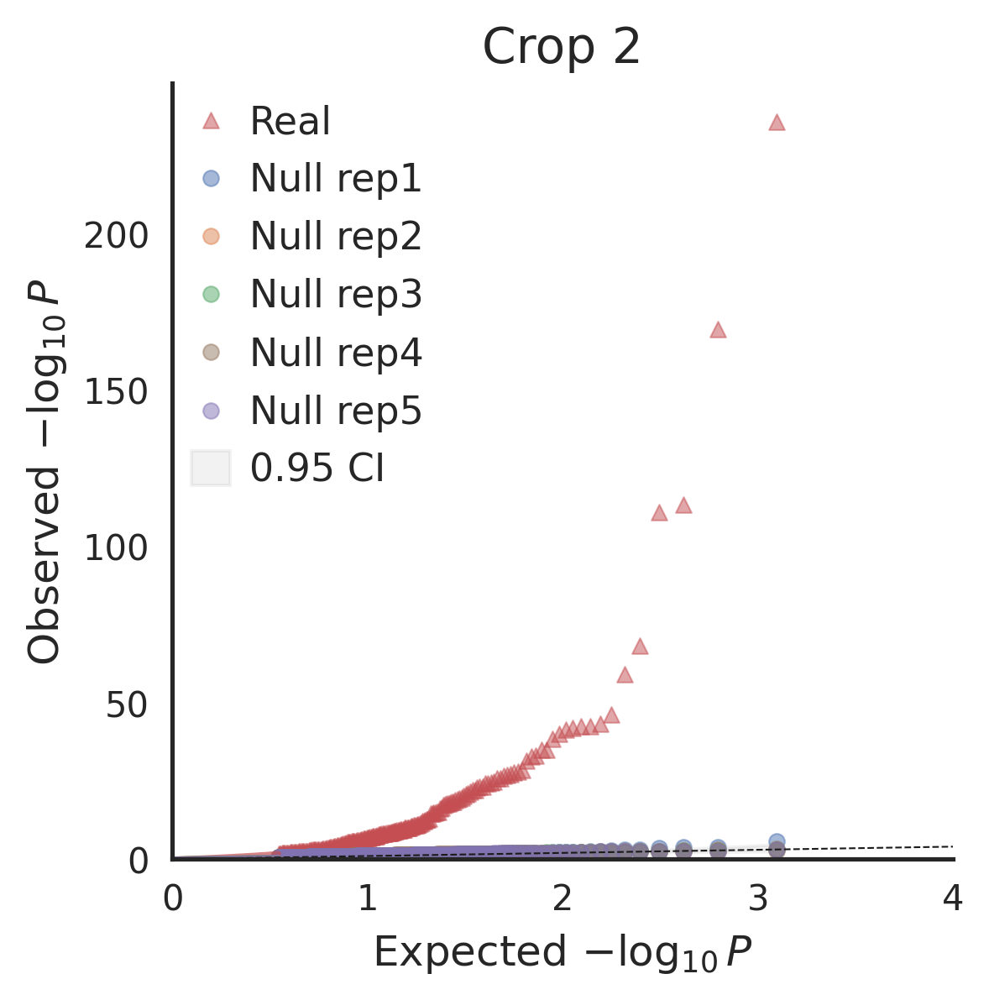

In [31]:
## cov test qqplot: real and null
sns.set_theme(style='white')
fig, ax = plt.subplots(1, 1, figsize=(4, 4), dpi=300)
qqplot(meta2['cov_real_null'], ['Real']+[f'Null rep{i}' for i in range(1,6)], ms=20,
       color=['C3', 'C0', 'C1', 'C2', 'C5', 'C4'], shape=['^','o','o','o','o','o'], 
       distribution='beta', ax=ax, title='Crop 2')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

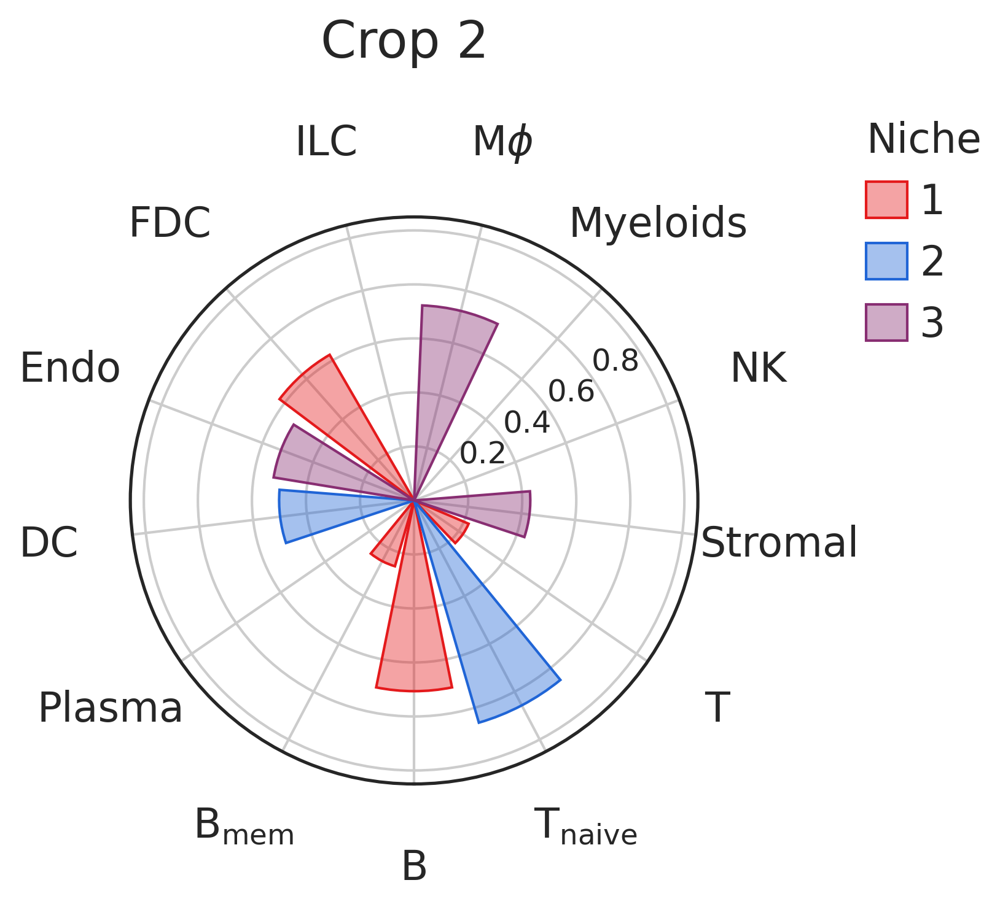

In [34]:
## representative cell niches: V radar plot
vdf2 = meta2['vdf']
comps2 = [1, 4, 2]
colors = [cmap_niche(i) for i in range(3)]
xticklabels = [ct_name_dict[x] for x in vdf2.index.tolist()]
draw_v_radar(vdf2, comps2, v_thres=0.2, colors=colors, alpha=0.8, width=0.4, offset=0.07, 
             xticklabels=xticklabels, rlabel_angle=235, figsize=(4,4), dpi=300, xtick_fs=16, xlabel_pad=20, 
             ylim=(0,1.05), yticks=[0.2,0.4,0.6,0.8,1.0], yticklabels=['0.2','0.4','0.6','0.8',''], ytick_fs=12, 
             leg_loc='upper right', leg_pos=(1.5,1.17), leg_ncol=1, leg_title='Niche', leg_fs=16, leg_title_fs=16, 
             title='Crop 2', title_fs=20, title_y=1.15)


# Main results
Analysis of T cell niche 1 and niche 2 across Xenium crop 1 and crop 2. Note: Niche 1/2 are not necessarily the first or second CCA components. They are GC- and T zone-associated niches, and we named them as niche 1 and niche 2.

## Candidate gene selection
Consistency of gene-level p-values in covariance tests on Xenium crop 1 and crop 2.

In [35]:
cov1, udf1, vdf1 = meta1['cov_target'], meta1['udf'], meta1['vdf']
cov2, udf2, vdf2 = meta2['cov_target'], meta2['udf'], meta2['vdf']

In [45]:
## p-value consistency
df = pd.merge(cov1, cov2, how='inner', on='gene_id')
sel_genes = ['TOX2', 'CXCL13', 'MS4A1', 'CD79A', 'POU2AF1', 'BCL6', 'GZMB', 'IL21']
x = -np.log10(df['vec_pval_x'])
y = -np.log10(df['vec_pval_y'])
r = ss.pearsonr(x, y)[0]

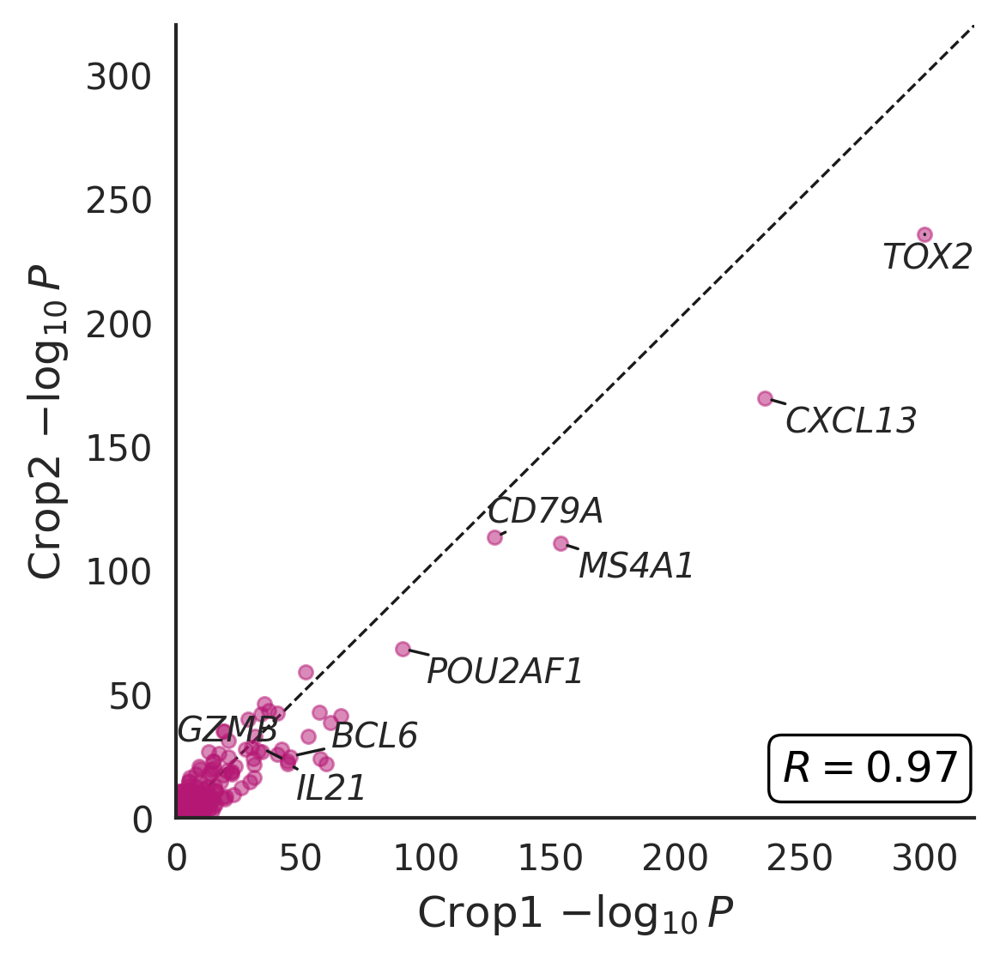

In [46]:
tick_font = 10
label_font = 12
color = '#b51774'
sns.set_theme(style="white")
sns.set_context('paper', font_scale=1.)

fig, ax = plt.subplots(1, 1, figsize=(4,4), dpi=300)
ax.axline((0,0), slope=1, linestyle='--', linewidth=0.8, color='k', zorder=1)
ax.scatter(x, y, marker='o', linewidths=0.7, edgecolor=color, facecolor=color, alpha=0.5, s=15)
font_ratio = {'family': 'sans',
              'style': 'italic',
        'color':  'black',
        'weight': 'normal',
        'size': label_font,
        'bbox': dict(boxstyle="round",
                   facecolor='white',
                   edgecolor='black',
                   lw=0.8
                   )
        }
ax.text(278, 20, f"$R={r:.2f}$", fontdict=font_ratio, horizontalalignment='center', verticalalignment='center')
ax.set_xlim(0,320)
ax.set_ylim(0,320)
ax.set_xticks(np.arange(0,310,50))
ax.set_yticks(np.arange(0,310,50))
ax.set_xlabel('Crop1 $-\log_{10} P$', fontsize=label_font)
ax.set_ylabel('Crop2 $-\log_{10} P$', fontsize=label_font)
ax.tick_params(axis='both', which='major', length=3, width=1, labelsize=tick_font)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
# annotate top genes with low p-value
texts = []
for gene in sel_genes:
    row = df.loc[df.gene_id==gene]
    tx = -np.log10(row['vec_pval_x'].values[0])
    ty = -np.log10(row['vec_pval_y'].values[0])
    ha, va = 'left', 'top'
    if gene in ['CD79A', 'GZMB']:
        ha, va = 'right', 'bottom'
    texts.append(ax.text(tx, ty, gene, ha=ha, va=va, fontdict={'family': 'sans', 'style': 'italic'}))
adjust_text(texts, force_text=(0.1,0.1), force_static=(0.1,0.1), expand=(1.4,1.5), arrowprops=dict(arrowstyle='-', color='k'))


## Niche cell types: spatial distribution
Spatial distributions of main niche cell types of T cell niche 1 and niche 2 within niche region on Xenium two crops.

In [61]:
def get_niche_cell_ids(meta, crop, comp, niche_quantile, sigma=20, cutoff=0.05):
    
    comp_col = f'S_comp{comp}'
    niche_cts = meta['vdf'].loc[meta['vdf'][f'comp{comp}']>0.2].sort_values(f'comp{comp}', ascending=False).index.tolist()
    print(niche_cts)
    if len(niche_cts) > 3:
        niche_cts = niche_cts[:3]
        print(f'Top 3 niche cts: {niche_cts}')
    target_df = meta['score_df'].copy()[['cell_id', 'x', 'y', comp_col]]
    tmp = meta['score_df'][comp_col]
    tmp = tmp[tmp > 0]
    thres = np.quantile(tmp, niche_quantile)
    target_df = target_df.loc[target_df[comp_col] > thres]
    print(f'Keep {len(target_df)} / {len(tmp)} target cells.')
    all_df = crop.obs.copy()[['cell_id', 'x', 'y', 'cell_type']]
    K_target = cdist(target_df[['x', 'y']].values, all_df[['x', 'y']].values)
    K_target = np.exp(-K_target**2/sigma**2)
    K_target[K_target < cutoff] = 0
    keep_niche_cell_ids = np.where(K_target.sum(0)>0)[0]
    keep_niche_cell_ids = all_df.cell_id.values[keep_niche_cell_ids]
    
    return keep_niche_cell_ids, niche_cts

def draw_niche_ct_within_niche(crop, keep_niche_cell_ids, ct_cmap_dict, niche_cts,
                             ms_bg = 4, color_bg = '#F0F0F0', lw_bg = 0, 
                             ms = 6, ecolor = '#C0C0C0', lw = 0.4,
                             ylabel=None, label_fs=24, 
                             leg_loc=None, leg_pos=None, leg_ncol=1, leg_fs=20, leg_ms=4,
                             title=None, title_fs=30, figsize=(8,8), dpi=300):
    
    fig, ax = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
    # background
    bg_df = crop.obs.loc[~crop.obs.cell_id.isin(keep_niche_cell_ids)]
    ax.scatter(bg_df['x'], bg_df['y'], ms_bg, facecolors=color_bg, edgecolor=color_bg, lw=lw_bg)
    # cells in niche
    niche_df = crop.obs.loc[crop.obs.cell_id.isin(keep_niche_cell_ids)]
    niche_df['color'] = niche_df['cell_type'].map(ct_cmap_dict)
    cts = niche_df.cell_type.value_counts().index.tolist()
    
    df = niche_df.loc[~niche_df.cell_type.isin(niche_cts)]
    ax.scatter(df['x'], df['y'], ms_bg, facecolors=color_bg, edgecolor=color_bg, lw=lw_bg)
    df = niche_df.loc[niche_df.cell_type.isin(niche_cts)]
    sca = ax.scatter(df['x'], df['y'], ms, facecolors='none', edgecolors=df['color'], lw=lw)
    
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_ylabel(ylabel, fontsize=label_fs, labelpad=10)
    ax.invert_yaxis()
    for s in ['top', 'bottom', 'right', 'left']:
        ax.spines[s].set_visible(False)

    legend_elements = []
    for i, ct in enumerate(niche_cts):
        c = ct_cmap_dict[ct]
        ele = mlines.Line2D([], [], color='w', marker='o', markersize=12, 
                            markeredgecolor=c, markerfacecolor='none', label=ct)
        legend_elements.append(ele)
    leg = ax.legend(handles=legend_elements, bbox_to_anchor=leg_pos, loc=leg_loc, 
                    borderpad=0, borderaxespad=0, ncol=leg_ncol,
                    framealpha=0, markerscale=1, fontsize=leg_fs, 
                    handletextpad=0.2, columnspacing=0.5)

    ax.margins(0,0)


### Niche 1

['FDC', 'B', 'B_mem', 'T']
Top 3 niche cts: ['FDC', 'B', 'B_mem']
Keep 614 / 1228 index cells.


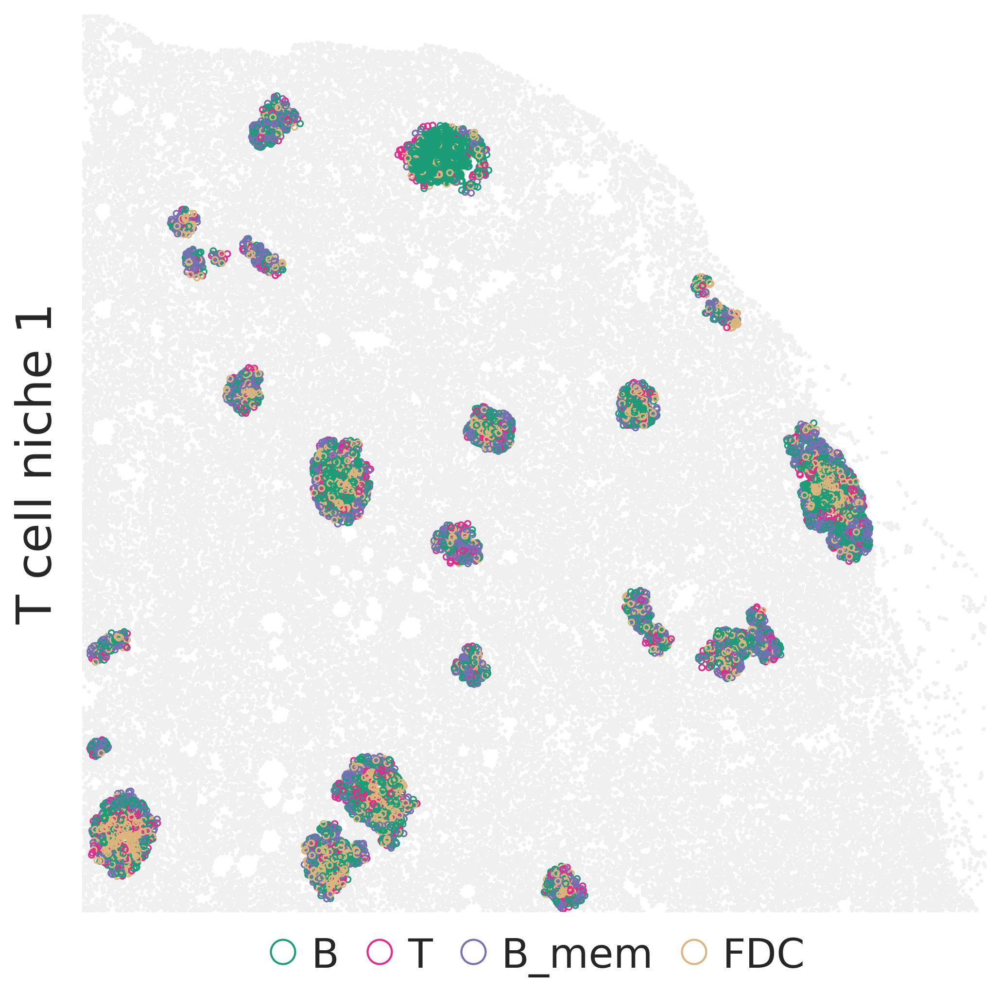

In [62]:
## crop 1 niche 1
comp = 1
niche_ct = ['B', 'T', 'B_mem', 'FDC']
keep_niche_cell_ids, _ = get_niche_cell_ids(meta1, crop1, comp, niche_quantile=0.5)
cmap_im = mpl.colors.LinearSegmentedColormap.from_list('cmap_im', ['#FFFFFF', cmap_niche(0)])
sca = draw_niche_ct_within_niche(crop1, keep_niche_cell_ids, ct_cmap_dict, niche_cts=niche_ct, 
                 leg_loc='center', leg_pos=(0.5,-0.05), leg_ncol=len(niche_ct), 
                 ylabel=f'T cell niche 1', ms=8, lw=0.8, figsize=(8,8))

['B', 'FDC', 'B_mem', 'T']
Top 3 niche cts: ['B', 'FDC', 'B_mem']
Keep 541 / 1082 index cells.


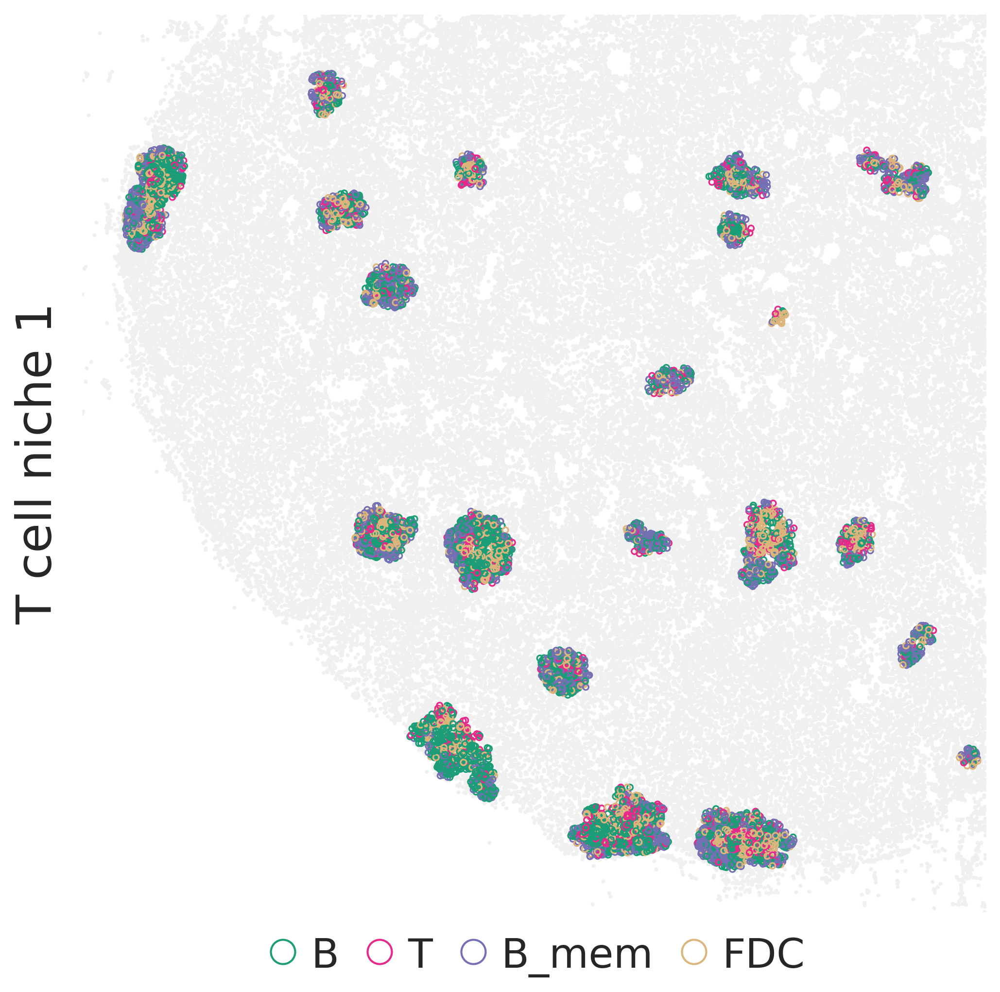

In [66]:
## crop 2 niche 1
comp = 1
niche_ct = ['B', 'T', 'B_mem', 'FDC']
keep_niche_cell_ids, _ = get_niche_cell_ids(meta2, crop2, comp, niche_quantile=0.5)
cmap_im = mpl.colors.LinearSegmentedColormap.from_list('cmap_im', ['#FFFFFF', cmap_niche(0)])
sca = draw_niche_ct_within_niche(crop2, keep_niche_cell_ids, ct_cmap_dict, niche_cts=niche_ct, 
                 leg_loc='center', leg_pos=(0.5,-0.05), leg_ncol=len(niche_ct), 
                 ylabel=f'T cell niche 1', ms=8, lw=0.8, figsize=(8,8))

### Niche 2

['T_naive', 'DC']
Keep 896 / 1792 index cells.


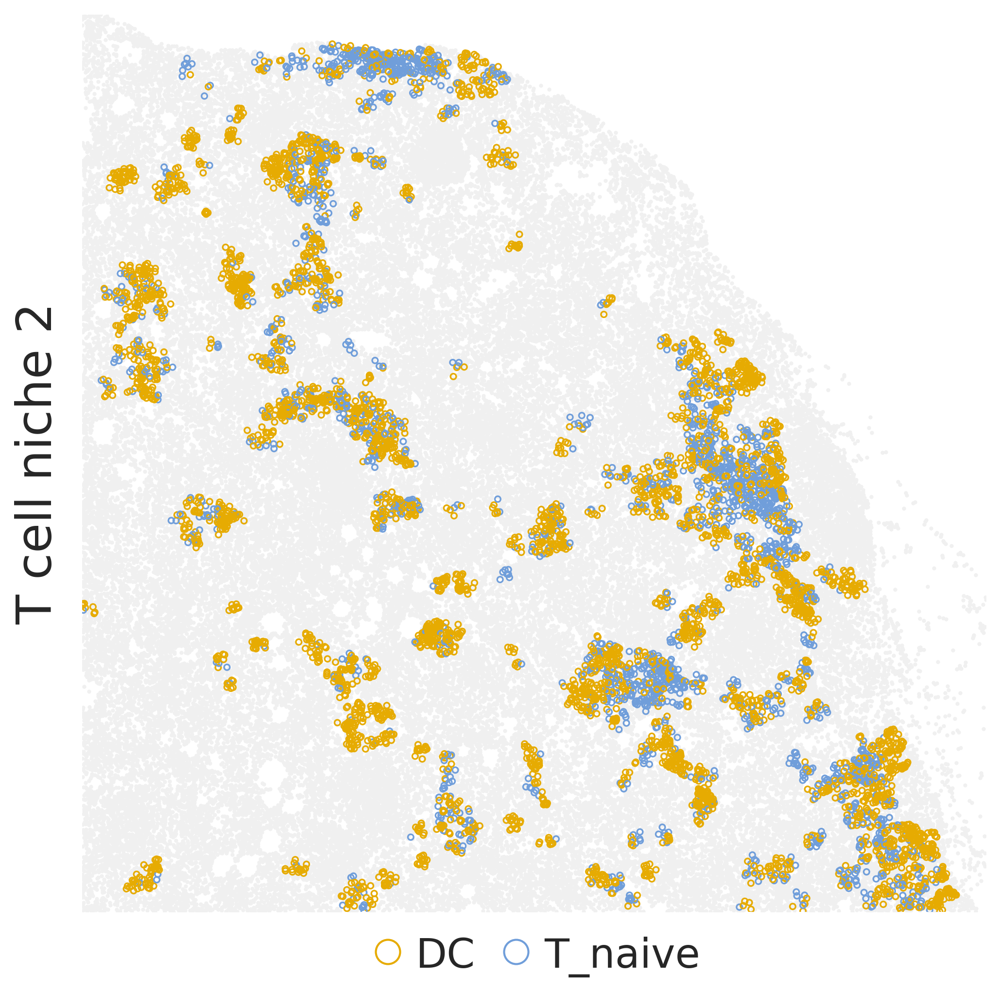

In [63]:
## crop 1 niche 2
comp = 2
niche_ct = ['DC', 'T_naive']
keep_niche_cell_ids, _ = get_niche_cell_ids(meta1, crop1, comp, niche_quantile=0.5)
cmap_im = mpl.colors.LinearSegmentedColormap.from_list('cmap_im', ['#FFFFFF', cmap_niche(0)])
sca = draw_niche_ct_within_niche(crop1, keep_niche_cell_ids, ct_cmap_dict, niche_cts=niche_ct, 
                 leg_loc='center', leg_pos=(0.5,-0.05), leg_ncol=len(niche_ct), 
                 ylabel=f'T cell niche 2', ms=8, lw=0.8, figsize=(8,8))

['T_naive', 'DC']
Keep 699 / 1399 index cells.


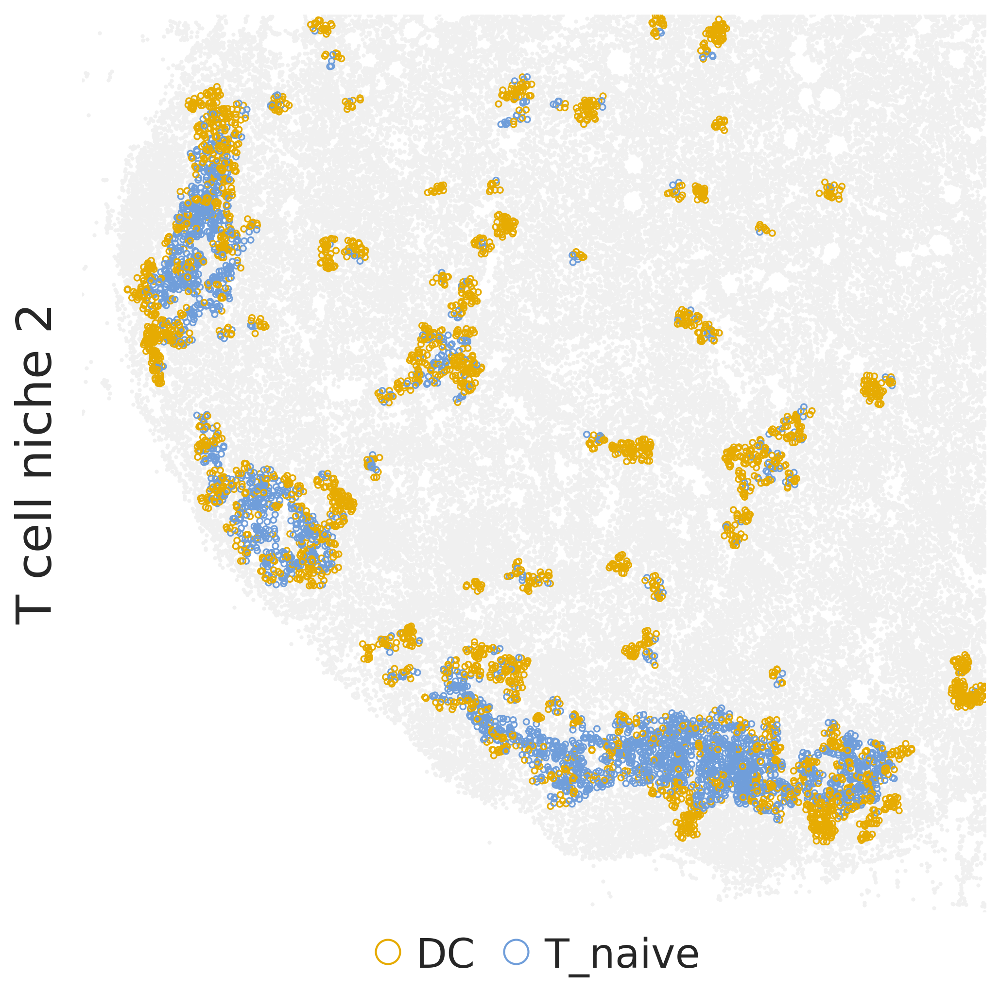

In [67]:
## crop 2 niche 2
comp = 4
niche_ct = ['DC', 'T_naive']
keep_niche_cell_ids, _ = get_niche_cell_ids(meta2, crop2, comp, niche_quantile=0.5)
cmap_im = mpl.colors.LinearSegmentedColormap.from_list('cmap_im', ['#FFFFFF', cmap_niche(0)])
sca = draw_niche_ct_within_niche(crop2, keep_niche_cell_ids, ct_cmap_dict, niche_cts=niche_ct, 
                 leg_loc='center', leg_pos=(0.5,-0.05), leg_ncol=len(niche_ct), 
                 ylabel=f'T cell niche 2', ms=8, lw=0.8, figsize=(8,8))

## Niche score: spatial distribution
Spatial distribution of niche scores of T cell niche 1 and niche 2 on Xenium two crops.

In [109]:
### spatial distribution of niche score and specific genes' expression in a window
def draw_niche_score_genes_window(target_df, niche_df, col, window, cts, genes, gene_colors=None, 
                                  z=None, draw_kde=False, target_color=None, ct_name_map=None, 
                                  adata=None, target_ct=None, draw_bg=False, bg_color='#F8F8F8', ms_bg=2, 
                                  niche_cts=None, niche_colors=None, bg_facecolor='#F8F8F8', 
                                  cmap_im=mpl.colormaps['magma'], ms_niche=8, lw_niche=0.6, alpha=1, 
                                  ylabel=None, fs=16, title=None, figsize=(6, 6), dpi=300, add_frame=False, 
                                  leg_pos=(0.5,-0.02), leg_loc="upper center", leg_ncol=2, leg_mks=4, 
                                  show_kde_cb=False, kde_cb_title=None, kde_cb_anchor=None, leg_title_fs=16):

    n = len(cts)
    x0, y0, xl, yl = window
    window_lims = [x0, x0+xl, y0, y0+yl]

    fig, ax = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
    ## bg
    if draw_bg:
        bg_df = adata[(adata.obs.x>x0)&(adata.obs.x<x0+xl)&(adata.obs.y>y0)&(adata.obs.y<y0+yl)&(adata.obs.cell_type!=target_ct)&(~adata.obs.cell_id.isin(niche_df.cell_id))].obs.copy()
        ax.scatter(bg_df['x'], bg_df['y'], ms_bg, facecolor=bg_color, edgecolor=bg_color, lw=0)
    ## kde
    if draw_kde:
        hist, bin_edges = np.histogram(z.flatten(), bins=50)
        im_lims = {'vmin': bin_edges[np.argmax(hist)+1], 'vmax': bin_edges[-1]}
        ax.imshow(np.rot90(z), cmap=cmap_im, extent=window_lims, **im_lims, aspect='auto')
        if show_kde_cb:
            cb = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmap_im),
                 ax=ax, location='right', anchor=kde_cb_anchor, pad=0.1, fraction=0.02, aspect=10, orientation='vertical')
            cb.ax.set_title(kde_cb_title, loc='left', fontsize=leg_title_fs)
            cb.outline.set_visible(False)
            cb.set_ticks([])
    ## niche ct
    for (niche_ct, niche_color) in zip(niche_cts, niche_colors):
        niche_df_ = niche_df.loc[niche_df['cell_type']==niche_ct]
        label_ = niche_ct
        if ct_name_map is not None:
            if label_ in ct_name_map:
                label_ = ct_name_map[label_]
        ax.scatter(niche_df_['x'], niche_df_['y'], ms_niche, facecolors='None', alpha=alpha, edgecolor=niche_color, linewidth=lw_niche, label=label_)
    ## add target ct for legend
    if target_ct in target_df.cell_type.unique():
        niche_df_ = target_df.loc[target_df['cell_type']==target_ct]
    else:
        niche_df_ = target_df.loc[target_df['sub_cell_type']==target_ct]
    label_ = target_ct
    if ct_name_map is not None:
        if label_ in ct_name_map:
            label_ = ct_name_map[label_]
    ax.scatter(niche_df_['x'], niche_df_['y'], ms_niche, facecolors='None', alpha=alpha, edgecolor=target_color, linewidth=lw_niche, label=label_)
    ## genes
    for i, (ct, gene, color) in enumerate(zip(cts, genes, gene_colors[:n])):
        cmap_sca = mpl.colors.LinearSegmentedColormap.from_list('cmap_sca', [bg_color, color])
        cmap_sca = cmr.get_sub_cmap(cmap_sca, 0.0, 1)
        df = get_gene_window(adata, ct, gene, window)
        ax.scatter(df['x'], df['y'], ms_niche, df[gene], cmap=cmap_sca, alpha=alpha, edgecolor=color, lw=lw_niche)

    ## setting
    ax.set_xlim([window_lims[0], window_lims[1]])
    ax.set_ylim([window_lims[2], window_lims[3]])
    ax.invert_yaxis()
    ax.set_xticks([])
    ax.set_yticks([])
    for s in ['top', 'bottom', 'right', 'left']:
        ax.spines[s].set_visible(False)
    ax.set_ylabel(ylabel, fontsize=fs)

    ## add frame
    if add_frame:
        flw = 6
        rect = mpatches.Rectangle((window_lims[0], window_lims[2]), window_lims[1]-window_lims[0], window_lims[3]-window_lims[2], 
                                  linewidth=flw, linestyle='--', edgecolor='#000000', facecolor='none')
        ax.add_patch(rect)

    ## legend
    leg = ax.legend(bbox_to_anchor=leg_pos, loc=leg_loc, borderpad=0, borderaxespad=0, ncol=leg_ncol,
          framealpha=0, markerscale=leg_mks, fontsize=fs, handletextpad=0.2)
    for legobj in leg.legend_handles:
        legobj.set_linewidth(2.5)
    if not draw_kde:
        ax.set_facecolor(bg_facecolor)
    plt.show()


### get gene expression in window
def get_gene_window(crop, ct, gene, window=None):

    if not isinstance(gene, list):
        gene = [gene]
    if ct not in crop.obs.cell_type.unique():
        ct_key = 'sub_cell_type'
    else:
        ct_key = 'cell_type'
    X0 = crop[crop.obs[ct_key]==ct, gene].X.toarray().copy()
    X0_df = pd.DataFrame(X0, columns=gene)
    loc_df = crop.obs.loc[crop.obs[ct_key]==ct, ['cell_id', 'x', 'y', 'cell_type', 'sub_cell_type']].reset_index(drop=True).copy()
    df = pd.concat([X0_df, loc_df], axis=1)

    if window is not None:
        x0, y0, xl, yl = window
        df = df.loc[(df.x>x0)&(df.x<x0+xl)&(df.y>y0)&(df.y<y0+yl)]
    
    return df


### get ta and niche cells in a window
def get_target_niche_df_window(crop, score_df, window, sigma=20, cutoff=0.05):

    x0, y0, xl, yl = window
    window_lims = [x0, x0+xl, y0, y0+yl]
    crop_lims = [crop.obs.x.min(), crop.obs.x.max(), crop.obs.y.min(), crop.obs.y.max()]
    obs_df = sc.get.obs_df(crop, ['cell_id', 'x', 'y', 'cell_type'])
    target_df = score_df.loc[(score_df.x>x0)&(score_df.x<x0+xl)&(score_df.y>y0)&(score_df.y<y0+yl)]
    df0 = obs_df.loc[(obs_df.x>x0)&(obs_df.x<x0+xl)&(obs_df.y>y0)&(obs_df.y<y0+yl)]

    # kde
    K_target_window = cdist(target_df[['x', 'y']].values, df0[['x', 'y']].values)
    K_target_window = np.exp(-K_target_window**2/sigma**2)
    K_target_window[K_target_window < cutoff] = 0
    keep_niche_cell_ids = np.where(K_target_window.sum(0)>0)[0]
    niche_df = df0.reset_index(drop=True).iloc[keep_niche_cell_ids,:]
    
    return target_df, niche_df


### fit kernel density estimation of niche score across whole tissue section
def fit_kde_diff(score_df, col, z_quantile=1, bw=20, kernel=['gaussian', 'tophat']):
    
    assert col in score_df.columns, f'{col} not in score_df.columns!'
    x = score_df.x.values
    y = score_df.y.values
    z = score_df[col].values
    xy = np.vstack([x, y]).T # coordinates of points
    keep_ids = np.where(z <= np.quantile(z, z_quantile))[0]
    xy = xy[keep_ids,:]
    z = z[keep_ids]
    z = (z - z.min()) / (z.max() - z.min())

    kde1 = neighbors.KernelDensity(kernel=kernel, bandwidth=bw).fit(xy, sample_weight=z)
    kde0 = neighbors.KernelDensity(kernel=kernel, bandwidth=bw).fit(xy)
    
    return kde1, kde0


### draw kernel density estimation of niche score in a window
def sample_kde_diff(kde1, kde0, lims, nx=100, ny=100):
    
    xmin, xmax, ymin, ymax = lims
    xgrid, ygrid = np.mgrid[xmin:xmax:eval(f'{nx}j'), ymin:ymax:eval(f'{ny}j')]
    grid_coords = np.vstack([xgrid.ravel(), ygrid.ravel()]).T
    
    Z1 = kde1.score_samples(grid_coords)
    Z0 = kde0.score_samples(grid_coords)
    Z1 = np.reshape(np.exp(Z1), xgrid.shape)
    Z0 = np.reshape(np.exp(Z0), xgrid.shape)
    Z = Z1 - Z0
    Z = Z - Z.mean()
    
    return Z, Z1, Z0

### Niche 1

In [159]:
cmap_niche_score = mpl.colors.LinearSegmentedColormap.from_list('cmap_niche_score', ['#FFFFFF', cmap_niche(0)])

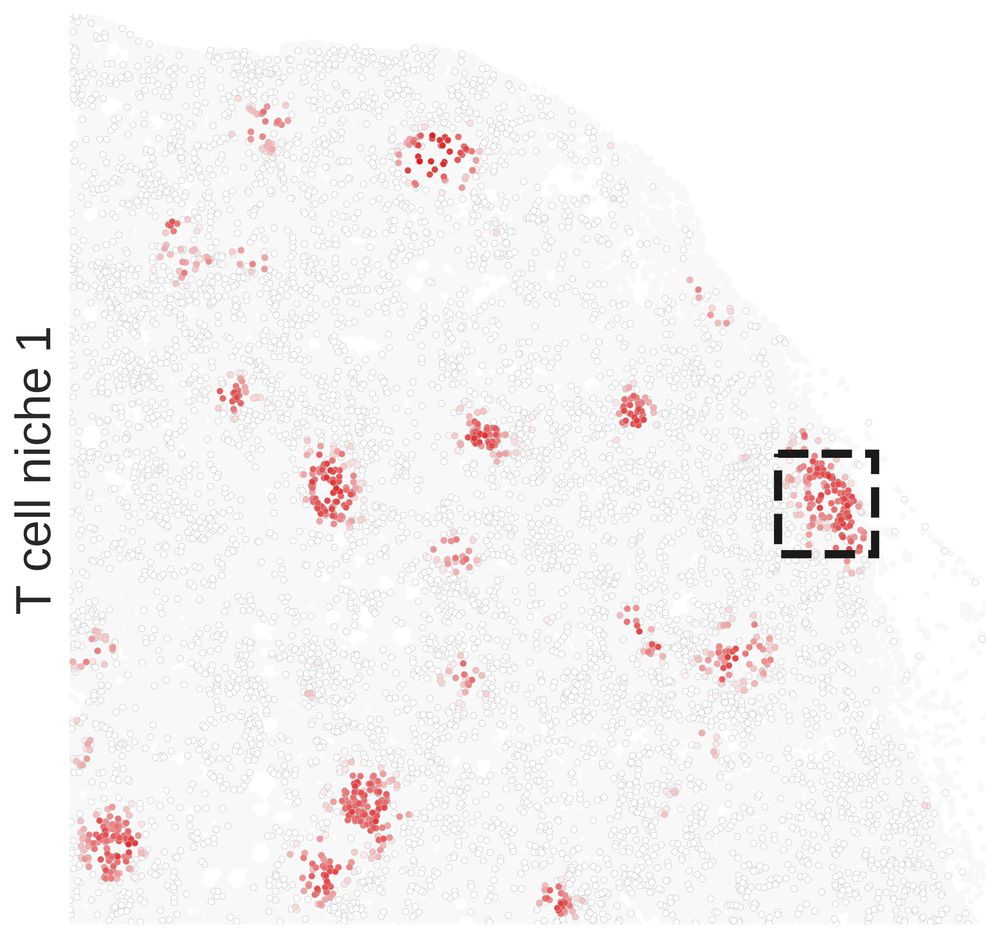

In [160]:
## crop 1
window = [6250, 1760, 350, 350]
draw_niche_score_spatial(crop1, meta1['score_df'], 'S_comp1', target_ct='T', 
                         draw_bg=True, bg_color='#F8F8F8', ms_bg=10, sort_score=True, 
                         cmap=cmap_niche_score, target_ec='#C0C0C0', ms=10, lw=0.2, 
                         window=window, window_lw=4, window_ls='--', window_lc='k', 
                         ylabel='T cell niche 1', ylabel_fs=24, title=None, title_fs=24, 
                         show_colorbar=False, cb_label=None, cb_tick_fs=20, 
                         figsize=(8,8), dpi=300, no_ticks=True, 
                         aspect='auto', invert_yaxis=True)

In [161]:
## calculate kde: crop 1 window
col = f'S_comp1'
bg_facecolor = '#F8F8F8'
score_df = meta1['score_df'].copy()
target_df, niche_df = get_target_niche_df_window(crop1, score_df, window)
kde1, kde0 = fit_kde_diff(score_df, col=col, z_quantile=1, bw=15, kernel='gaussian')
t0 = time.time()
x0, y0, xl, yl = window
window_lims = [x0, x0+xl, y0, y0+yl]
z_win, z1_win, z0_win = sample_kde_diff(kde1, kde0, window_lims, nx=200, ny=200)
t1 = time.time()
print('Calculated kernel density estimation (KDE) of niche score in window (%ds)' % (t1 - t0))

Calculated kernel density estimation (KDE) of niche score in window (82s)


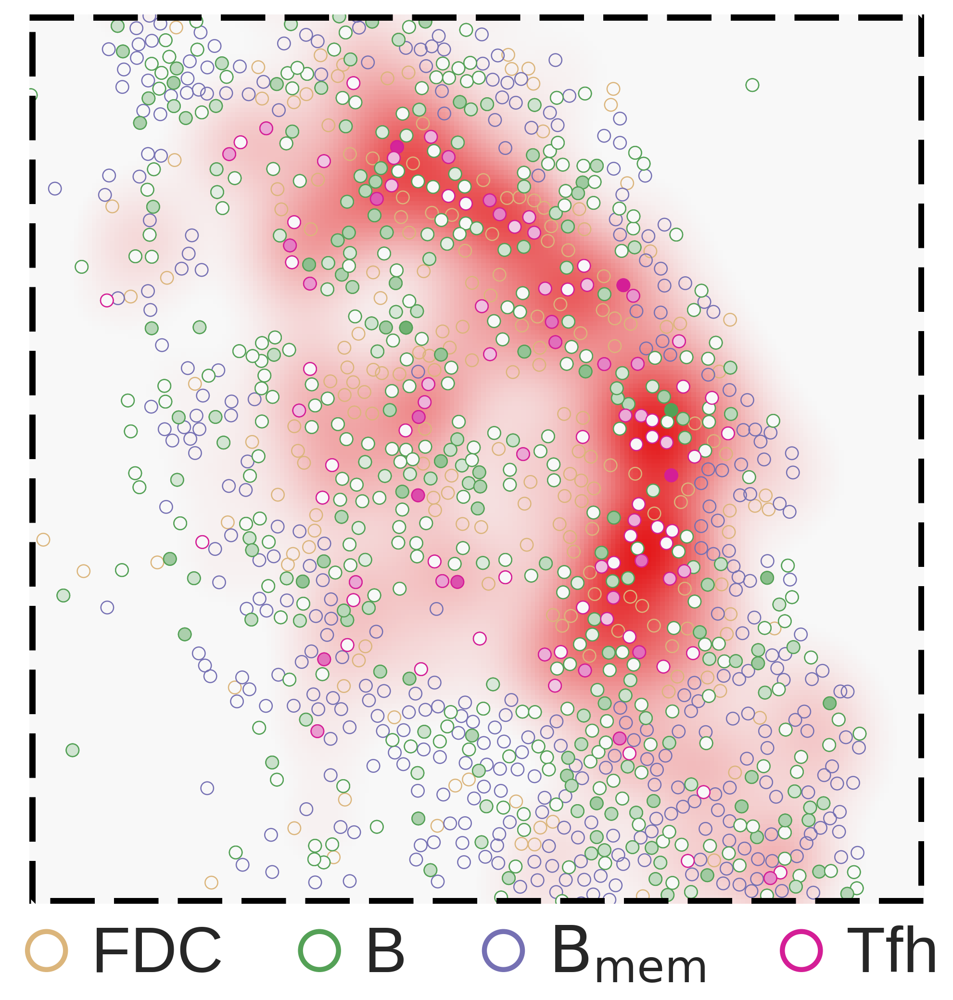

In [116]:
## draw niche score kde and selected genes: crop 1 window
ct_color_dict = {'FDC': '#dbb57b',
                 'B': '#1b9e77',
                 'B_mem': '#1b9e77',
                 'T_CD4+_TfH_GC': '#d41e96'}
target_ct = 'T_CD4+_TfH_GC'
niche_cts = ['FDC', 'B', 'B_mem']
gene_cts = ['B', 'T_CD4+_TfH_GC']
genes = ['CD40', 'CD40LG']
gene_colors = [ct_color_dict[k] for k in gene_cts]
niche_colors = [ct_color_dict[k] for k in niche_cts]
target_color = ct_color_dict[target_ct]
cmap_im = mpl.colors.LinearSegmentedColormap.from_list('cmap_niche', [bg_facecolor, cmap_niche(0)])
draw_niche_score_genes_window(target_df, niche_df, col, window, gene_cts, genes,
                      z=z_win, draw_kde=True, ct_name_map=subct_name_dict,
                      gene_colors=gene_colors, target_color=target_color,
                      adata=crop1, target_ct=target_ct, draw_bg=False, bg_color=bg_facecolor, ms_bg=20,
                      niche_cts=niche_cts, niche_colors=niche_colors, bg_facecolor=bg_facecolor,
                      cmap_im=cmap_im, ms_niche=40, lw_niche=0.6, alpha=1, 
                      ylabel=None, fs=32, title=None, figsize=(8, 8), dpi=300, add_frame=True,
                      leg_pos=(0.5,-0.02), leg_loc="upper center", leg_ncol=4, leg_mks=3)

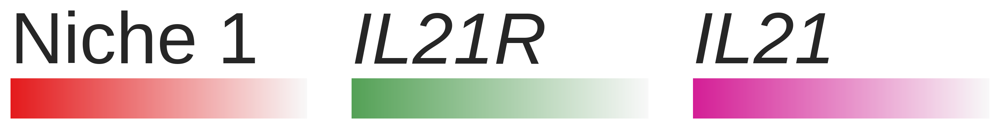

In [171]:
## legends of niche score kde and genes
fig, ax = plt.subplots(1, 3, figsize=(12,0.5), dpi=300)
colors_ = [cmap_niche(0), '#54a156', '#d41e96']
names_ = ['Niche 1'] + genes
styles_ = ['normal', 'italic', 'italic']
for i, (color_, name_, style_) in enumerate(zip(colors_, names_, styles_)):
    cmap_ = mpl.colors.LinearSegmentedColormap.from_list('cmap_', [color_, bg_facecolor])
    cb = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmap_),
             cax=ax[i], orientation='horizontal', aspect=5)
    cb.ax.set_title(name_, loc='left', fontsize=50, style=style_)
    cb.outline.set_visible(False)
    cb.set_ticks([])
plt.subplots_adjust(wspace=0.15)

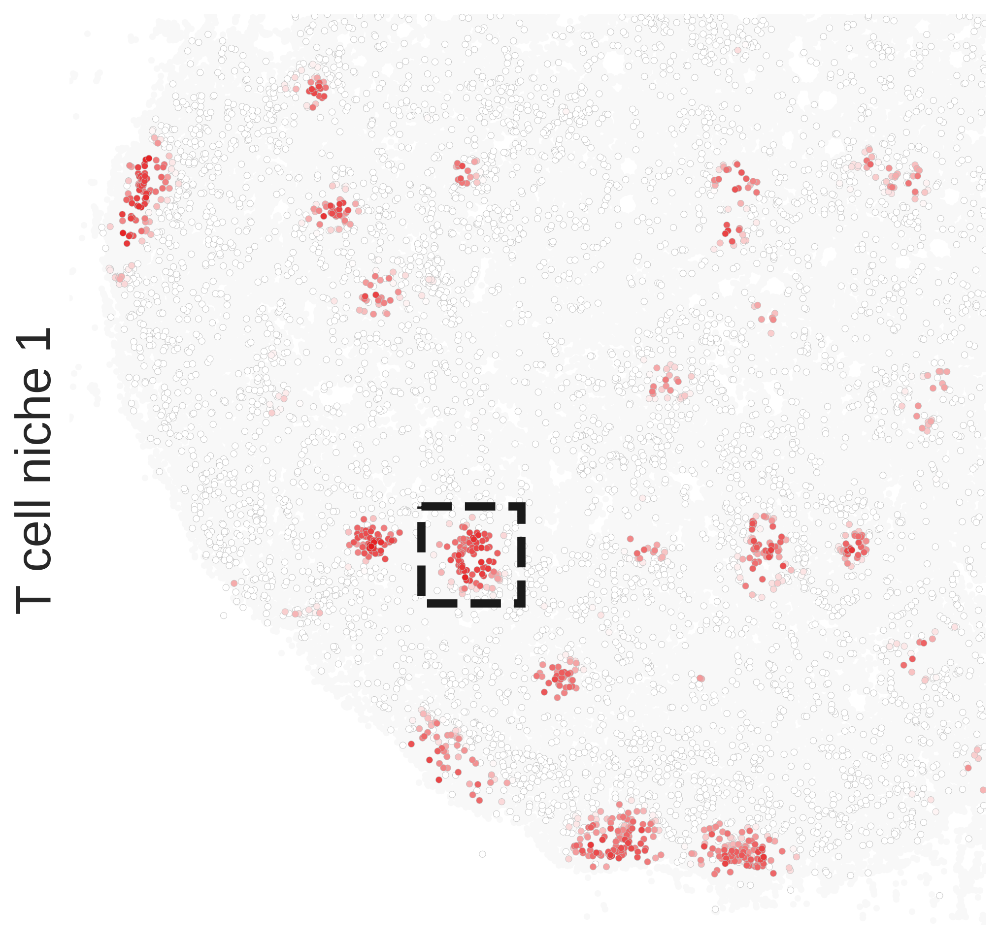

In [166]:
## crop 2
window = [1730, 4280, 350, 350]
draw_niche_score_spatial(crop2, meta2['score_df'], 'S_comp1', target_ct='T', 
                         draw_bg=True, bg_color='#F8F8F8', ms_bg=10, sort_score=True, 
                         cmap=cmap_niche_score, target_ec='#C0C0C0', ms=10, lw=0.2, 
                         window=window, window_lw=4, window_ls='--', window_lc='k', 
                         ylabel='T cell niche 1', ylabel_fs=24, title=None, title_fs=24, 
                         show_colorbar=False, cb_label=None, cb_tick_fs=20, 
                         figsize=(8,8), dpi=300, no_ticks=True, 
                         aspect='auto', invert_yaxis=True)

In [167]:
## calculate kde: crop 2 window
col = f'S_comp1'
bg_facecolor = '#F8F8F8'
score_df = meta2['score_df'].copy()
target_df, niche_df = get_target_niche_df_window(crop2, score_df, window)
kde1, kde0 = fit_kde_diff(score_df, col=col, z_quantile=1, bw=15, kernel='gaussian')
t0 = time.time()
x0, y0, xl, yl = window
window_lims = [x0, x0+xl, y0, y0+yl]
z_win, z1_win, z0_win = sample_kde_diff(kde1, kde0, window_lims, nx=200, ny=200)
t1 = time.time()
print('Calculated kernel density estimation (KDE) of niche score in window (%ds)' % (t1 - t0))

Calculated kernel density estimation (KDE) of niche score in window (61s)


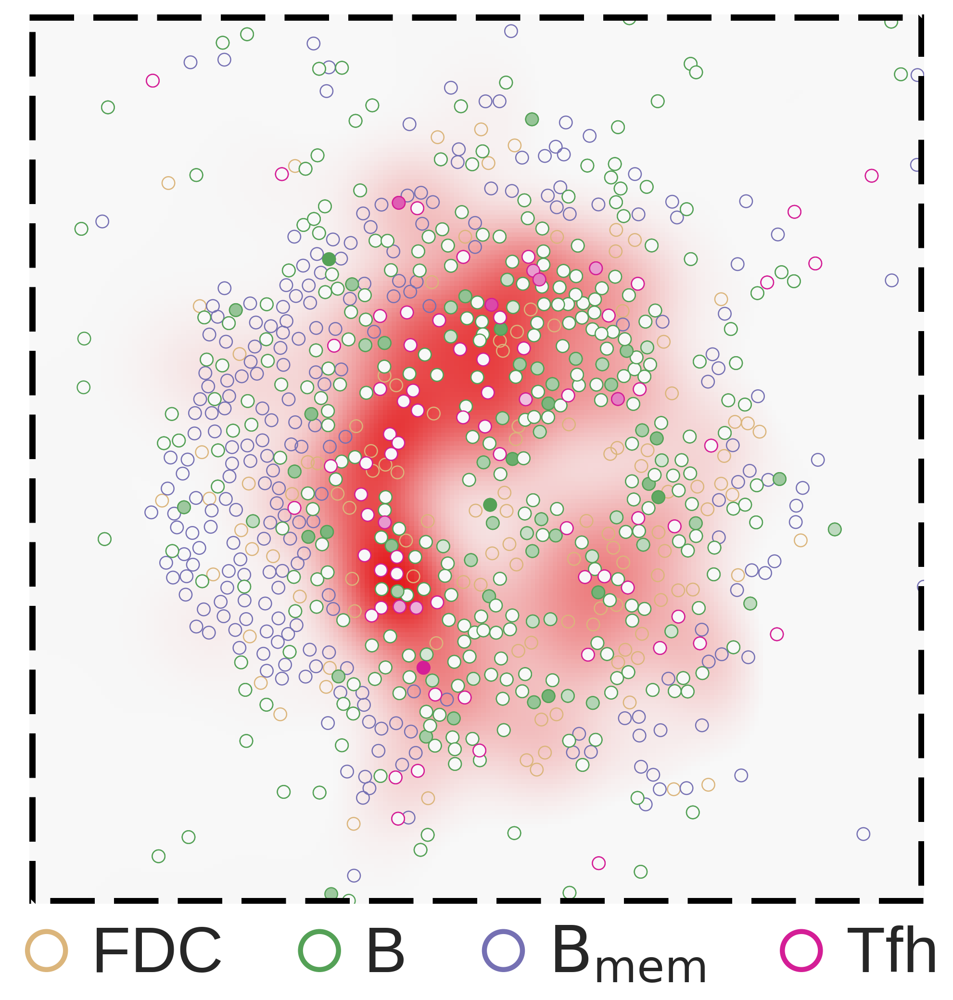

In [168]:
## draw niche score kde and selected genes: crop 1 window
ct_color_dict = {'FDC': '#dbb57b',
                 'B': '#54A156',
                 'B_mem': '#7570b3',
                 'T_CD4+_TfH_GC': '#d41e96'}
target_ct = 'T_CD4+_TfH_GC'
niche_cts = ['FDC', 'B', 'B_mem']
gene_cts = ['B', 'T_CD4+_TfH_GC']
genes = ['IL21R', 'IL21']
gene_colors = [ct_color_dict[k] for k in gene_cts]
niche_colors = [ct_color_dict[k] for k in niche_cts]
target_color = ct_color_dict[target_ct]
cmap_im = mpl.colors.LinearSegmentedColormap.from_list('cmap_niche', [bg_facecolor, cmap_niche(0)])
draw_niche_score_genes_window(target_df, niche_df, col, window, gene_cts, genes,
                      z=z_win, draw_kde=True, ct_name_map=subct_name_dict,
                      gene_colors=gene_colors, target_color=target_color,
                      adata=crop2, target_ct=target_ct, draw_bg=False, bg_color=bg_facecolor, ms_bg=20,
                      niche_cts=niche_cts, niche_colors=niche_colors, bg_facecolor=bg_facecolor,
                      cmap_im=cmap_im, ms_niche=40, lw_niche=0.6, alpha=1, 
                      ylabel=None, fs=32, title=None, figsize=(8, 8), dpi=300, add_frame=True,
                      leg_pos=(0.5,-0.02), leg_loc="upper center", leg_ncol=4, leg_mks=3)

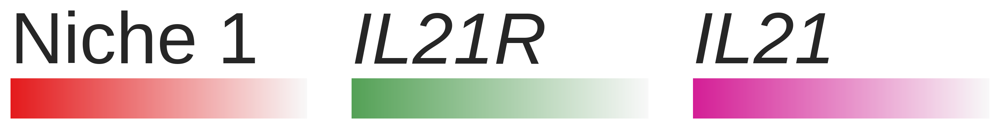

In [135]:
## legends of niche score kde and genes
fig, ax = plt.subplots(1, 3, figsize=(12,0.5), dpi=300)
colors_ = [cmap_niche(0), '#54a156', '#d41e96']
names_ = ['Niche 1'] + genes
styles_ = ['normal', 'italic', 'italic']
for i, (color_, name_, style_) in enumerate(zip(colors_, names_, styles_)):
    cmap_ = mpl.colors.LinearSegmentedColormap.from_list('cmap_', [color_, bg_facecolor])
    cb = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmap_),
             cax=ax[i], orientation='horizontal', aspect=5)
    cb.ax.set_title(name_, loc='left', fontsize=50, style=style_)
    cb.outline.set_visible(False)
    cb.set_ticks([])
plt.subplots_adjust(wspace=0.15)

### Niche 2

In [136]:
cmap_niche_score = mpl.colors.LinearSegmentedColormap.from_list('cmap_niche_score', ['#FFFFFF', cmap_niche(1)])

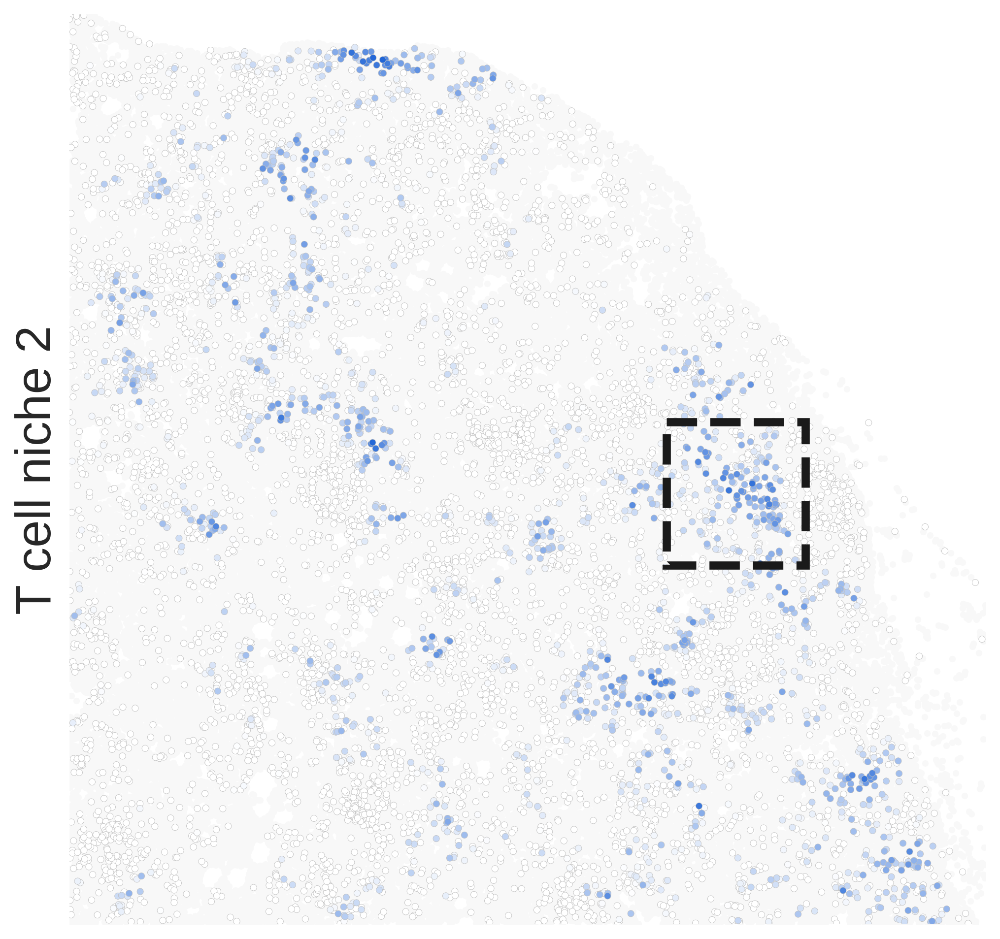

In [137]:
## crop 1
window = [5850, 1650, 500, 500]
draw_niche_score_spatial(crop1, meta1['score_df'], 'S_comp2', target_ct='T', 
                         draw_bg=True, bg_color='#F8F8F8', ms_bg=10, sort_score=True, 
                         cmap=cmap_niche_score, target_ec='#C0C0C0', ms=10, lw=0.2, 
                         window=window, window_lw=4, window_ls='--', window_lc='k', 
                         ylabel='T cell niche 2', ylabel_fs=24, title=None, title_fs=24, 
                         show_colorbar=False, cb_label=None, cb_tick_fs=20, 
                         figsize=(8,8), dpi=300, no_ticks=True, 
                         aspect='auto', invert_yaxis=True)

In [138]:
## calculate kde: crop 1 window
col = f'S_comp2'
bg_facecolor = '#F8F8F8'
score_df = meta1['score_df'].copy()
target_df, niche_df = get_target_niche_df_window(crop1, score_df, window)
kde1, kde0 = fit_kde_diff(score_df, col=col, z_quantile=1, bw=15, kernel='gaussian')
t0 = time.time()
x0, y0, xl, yl = window
window_lims = [x0, x0+xl, y0, y0+yl]
z_win, z1_win, z0_win = sample_kde_diff(kde1, kde0, window_lims, nx=200, ny=200)
t1 = time.time()
print('Calculated kernel density estimation (KDE) of niche score in window (%ds)' % (t1 - t0))

Calculated kernel density estimation (KDE) of niche score in window (75s)


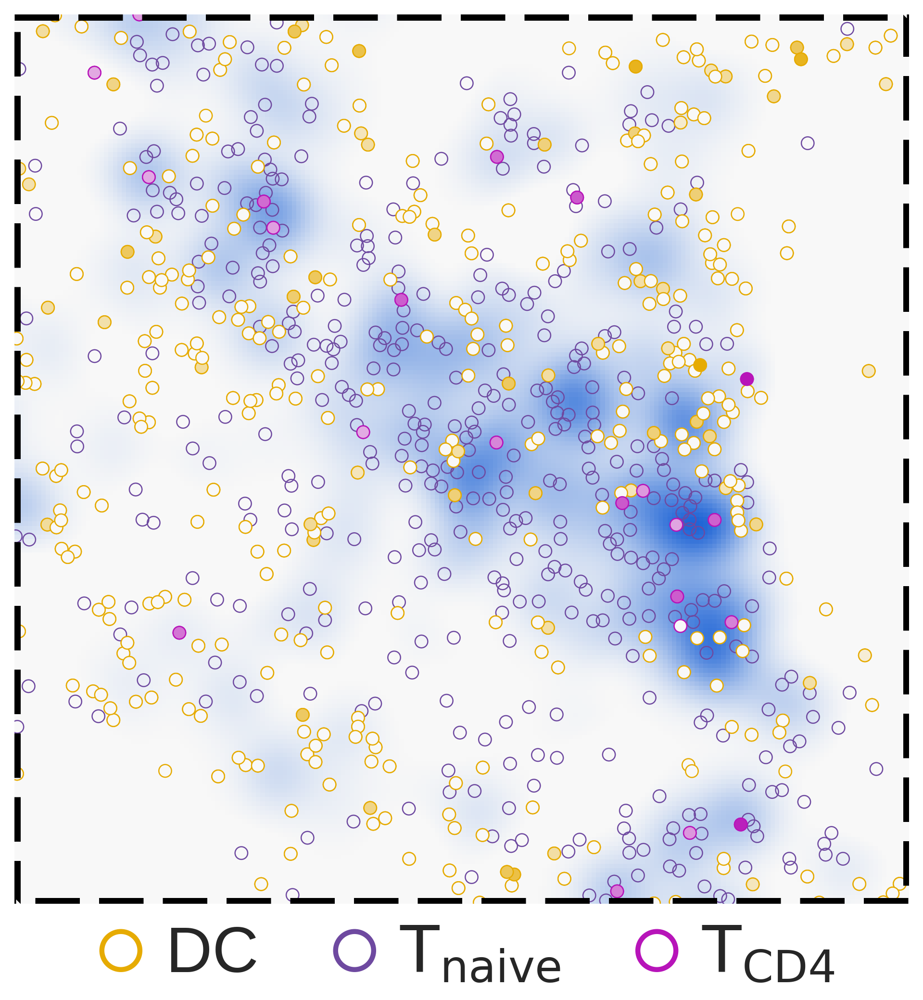

In [153]:
## draw niche score kde and selected genes: crop 1 window
ct_color_dict = {'DC': '#e6ab02',
                 'T_CD4+': '#b714b9',
                 'T_naive': '#6e49a0'}
target_ct = 'T_CD4+'
niche_cts = ['DC', 'T_naive']
gene_cts = ['DC', 'T_CD4+']
genes = ['FLT3', 'FLT3LG']
gene_colors = [ct_color_dict[k] for k in gene_cts]
niche_colors = [ct_color_dict[k] for k in niche_cts]
target_color = ct_color_dict[target_ct]
cmap_im = mpl.colors.LinearSegmentedColormap.from_list('cmap_niche', [bg_facecolor, cmap_niche(1)])
draw_niche_score_genes_window(target_df, niche_df, col, window, gene_cts, genes,
                      z=z_win, draw_kde=True, ct_name_map=subct_name_dict,
                      gene_colors=gene_colors, target_color=target_color,
                      adata=crop1, target_ct=target_ct, draw_bg=False, bg_color=bg_facecolor, ms_bg=20,
                      niche_cts=niche_cts, niche_colors=niche_colors, bg_facecolor=bg_facecolor,
                      cmap_im=cmap_im, ms_niche=40, lw_niche=0.6, alpha=1, 
                      ylabel=None, fs=32, title=None, figsize=(8, 8), dpi=300, add_frame=True,
                      leg_pos=(0.5,-0.02), leg_loc="upper center", leg_ncol=4, leg_mks=3)

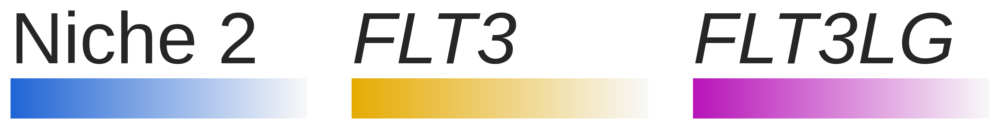

In [155]:
## legends of niche score kde and genes
fig, ax = plt.subplots(1, 3, figsize=(12,0.5), dpi=300)
colors_ = [cmap_niche(1), '#e6ab02', '#b714b9']
names_ = ['Niche 2'] + genes
styles_ = ['normal', 'italic', 'italic']
for i, (color_, name_, style_) in enumerate(zip(colors_, names_, styles_)):
    cmap_ = mpl.colors.LinearSegmentedColormap.from_list('cmap_', [color_, bg_facecolor])
    cb = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmap_),
             cax=ax[i], orientation='horizontal', aspect=5)
    cb.ax.set_title(name_, loc='left', fontsize=50, style=style_)
    cb.outline.set_visible(False)
    cb.set_ticks([])
plt.subplots_adjust(wspace=0.15)

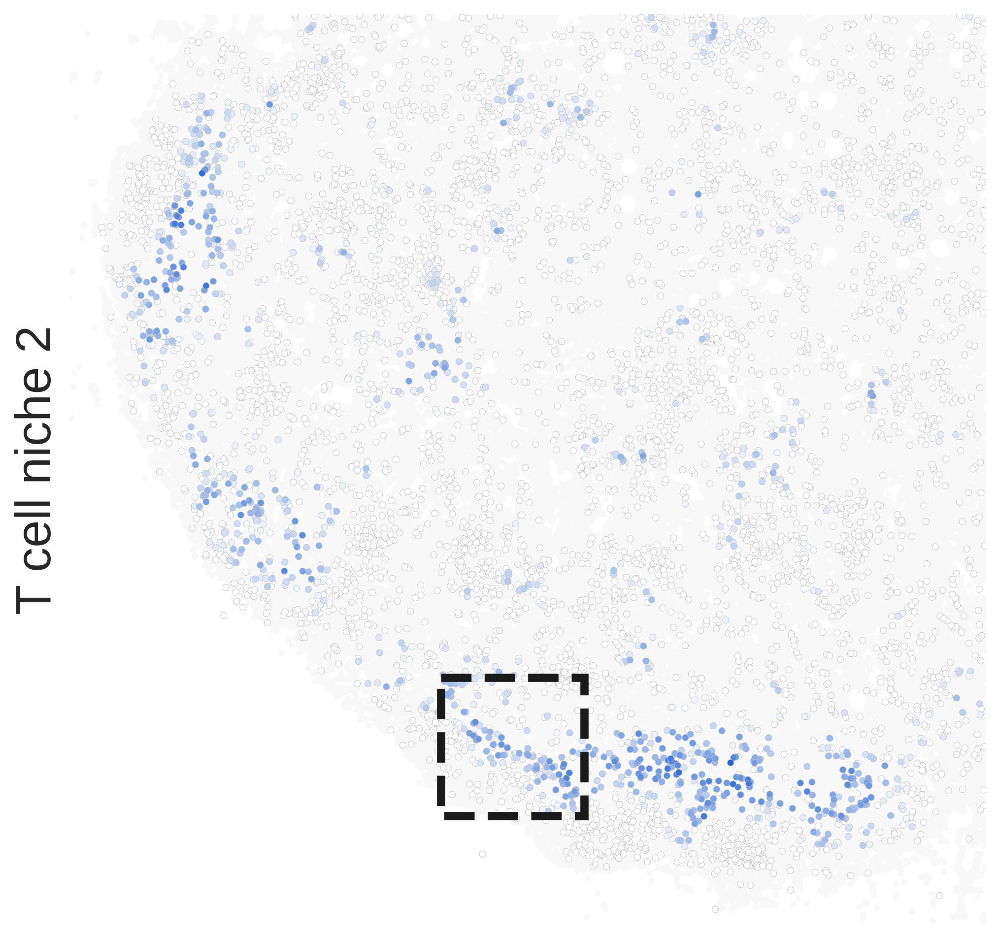

In [156]:
## crop 2
window = [1800, 4900, 500, 500]
draw_niche_score_spatial(crop2, meta2['score_df'], 'S_comp4', target_ct='T', 
                         draw_bg=True, bg_color='#F8F8F8', ms_bg=10, sort_score=True, 
                         cmap=cmap_niche_score, target_ec='#C0C0C0', ms=10, lw=0.2, 
                         window=window, window_lw=4, window_ls='--', window_lc='k', 
                         ylabel='T cell niche 2', ylabel_fs=24, title=None, title_fs=24, 
                         show_colorbar=False, cb_label=None, cb_tick_fs=20, 
                         figsize=(8,8), dpi=300, no_ticks=True, 
                         aspect='auto', invert_yaxis=True)

In [157]:
## calculate kde: crop 1 window
col = f'S_comp4'
bg_facecolor = '#F8F8F8'
score_df = meta2['score_df'].copy()
target_df, niche_df = get_target_niche_df_window(crop2, score_df, window)
kde1, kde0 = fit_kde_diff(score_df, col=col, z_quantile=1, bw=15, kernel='gaussian')
t0 = time.time()
x0, y0, xl, yl = window
window_lims = [x0, x0+xl, y0, y0+yl]
z_win, z1_win, z0_win = sample_kde_diff(kde1, kde0, window_lims, nx=200, ny=200)
t1 = time.time()
print('Calculated kernel density estimation (KDE) of niche score in window (%ds)' % (t1 - t0))

Calculated kernel density estimation (KDE) of niche score in window (66s)


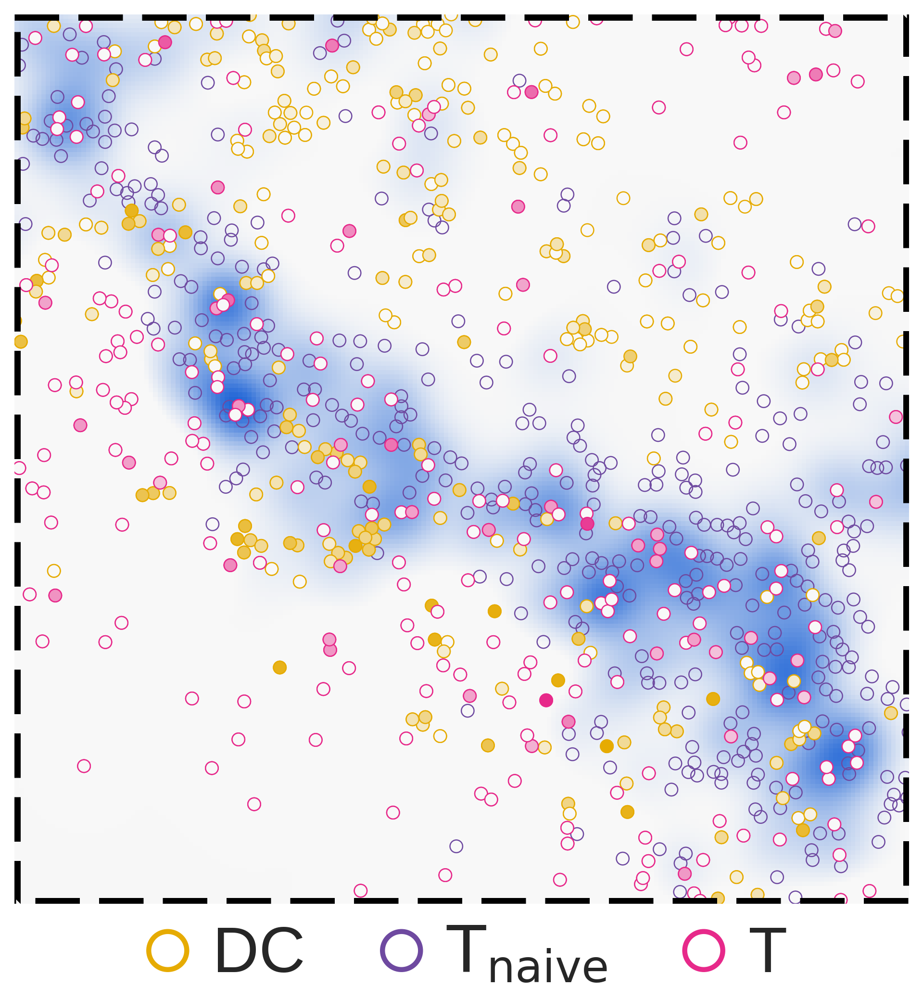

In [158]:
## draw niche score kde and selected genes: crop 2 window
ct_color_dict = {'DC': '#e6ab02',
                 'T': '#e7298a',
                 'T_naive': '#6e49a0'}
target_ct = 'T'
niche_cts = ['DC', 'T_naive']
gene_cts = ['DC', 'T']
genes = ['CCL19', 'CCR7']
gene_colors = [ct_color_dict[k] for k in gene_cts]
niche_colors = [ct_color_dict[k] for k in niche_cts]
target_color = ct_color_dict[target_ct]
cmap_im = mpl.colors.LinearSegmentedColormap.from_list('cmap_niche', [bg_facecolor, cmap_niche(1)])
draw_niche_score_genes_window(target_df, niche_df, col, window, gene_cts, genes,
                      z=z_win, draw_kde=True, ct_name_map=subct_name_dict,
                      gene_colors=gene_colors, target_color=target_color,
                      adata=crop2, target_ct=target_ct, draw_bg=False, bg_color=bg_facecolor, ms_bg=20,
                      niche_cts=niche_cts, niche_colors=niche_colors, bg_facecolor=bg_facecolor,
                      cmap_im=cmap_im, ms_niche=40, lw_niche=0.6, alpha=1, 
                      ylabel=None, fs=32, title=None, figsize=(8, 8), dpi=300, add_frame=True,
                      leg_pos=(0.5,-0.02), leg_loc="upper center", leg_ncol=4, leg_mks=3)

## Niche genes
Combined gene coefficients of T cell niche 1 and niche 2 on Xenium two crops.

In [172]:
### CCA components of niche 1 and 2
comps1 = [f'comp{x}' for x in [1, 2]]
comps2 = [f'comp{x}' for x in [1, 4]]
df = pd.merge(udf1[comps1], udf2[comps2], how='outer', left_index=True, right_index=True).fillna(0)
df.columns = ['crop1_niche1', 'crop1_niche2', 'crop2_niche1', 'crop2_niche2']

19
19


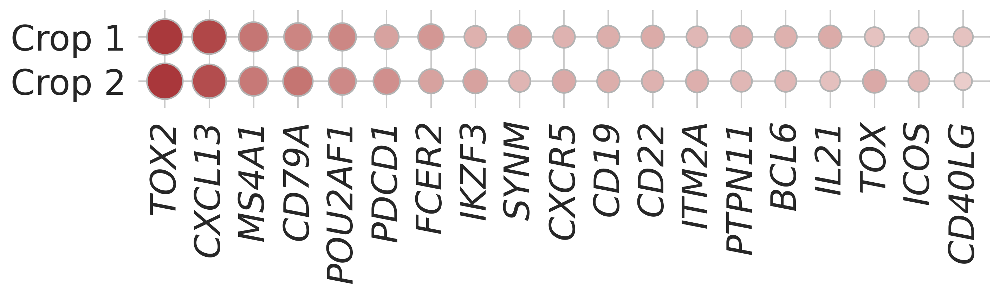

In [173]:
## niche1
n_top1 = 12
genes1 = df.sort_values('crop1_niche1', ascending=False).iloc[:n_top1].index.tolist()
genes2 = df.sort_values('crop2_niche1', ascending=False).iloc[:n_top1].index.tolist()
add_genes = ['BCL6', 'CXCR5', 'ICOS', 'CD40LG', 'IL21', 'PDCD1']
genes = sorted(set(genes1) | set(genes2) | set(add_genes))
print(len(genes))
ucolor_df0 = df[['crop1_niche1', 'crop2_niche1']].loc[genes]
ucolor_df0['sum'] = ucolor_df0['crop1_niche1'] + ucolor_df0['crop2_niche1']
ucolor_df0 = ucolor_df0.sort_values('sum', ascending=False)
ucolor_df0 = ucolor_df0.iloc[:,:2]
ucolor_df = ucolor_df0.stack().reset_index(name="u")
print(len(ucolor_df0))

sns.set_theme(style="whitegrid", rc={"grid.linewidth": 1})
sns.set_context('paper',font_scale=1.)
plt.rcParams.update({"figure.dpi": 300, "grid.linewidth": 1.})
h = 2
w = 0.5*len(ucolor_df0)
asp = w/h
fs = 24
sizes=(10, 600)
mx = 0.6/(len(ucolor_df0)-1)
my = 0.6/(2-1)
leg_pos=(1.03,0.95)
yticklabels = ['Crop 1', 'Crop 2']
title = None
csm = ucolor_df.u.max()
g = sns.relplot(
    data=ucolor_df, 
    x="level_0", y="level_1", hue="u", size="u",
    palette="vlag", hue_norm=(-csm, csm), edgecolor="0.7",
    height=h, aspect=asp, sizes=sizes, size_norm=(0, csm), legend=True, 
)
g.set(xlabel="", ylabel="", yticklabels=yticklabels, title=title, aspect='equal')

g.set_xticklabels(size = fs, style='italic', rotation=90)
g.set_yticklabels(size = fs, rotation=0)
g.despine(left=True, bottom=True)
g.ax.margins(x=mx, y=my)
g._legend.remove()

18
18


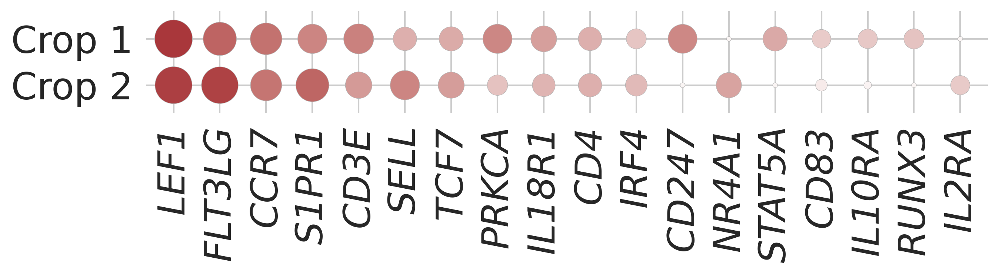

In [175]:
## niche2
n_top1 = 1
genes1 = df.sort_values('crop1_niche2', ascending=False).iloc[:n_top1].index.tolist()
genes2 = df.sort_values('crop2_niche2', ascending=False).iloc[:n_top1].index.tolist()
add_genes = ['CD3E', 'SELL', 'TCF7', 'CD247', 'CD4', 'IRF4', 'LEF1', 'PRKCA', 'CD83', 'STAT5A', 
             'IL10RA', 'RUNX3', 'IL18R1', 'S1PR1', 'NR4A1', 'IL2RA', 'FLT3LG', 'CCR7']
genes = sorted(set(genes1) | set(genes2) | set(add_genes))
print(len(genes))
ucolor_df0 = df[['crop1_niche2', 'crop2_niche2']].loc[genes]
ucolor_df0['sum'] = ucolor_df0['crop1_niche2'] + ucolor_df0['crop2_niche2']
ucolor_df0 = ucolor_df0.sort_values('sum', ascending=False)
ucolor_df0 = ucolor_df0.iloc[:,:2]
ucolor_df = ucolor_df0.stack().reset_index(name="u")
print(len(ucolor_df0))

sns.set_theme(style="whitegrid", rc={"grid.linewidth": 1})
sns.set_context('paper',font_scale=1.)
plt.rcParams.update({"figure.dpi": 300, "grid.linewidth": 1.})
h = 2
w = 0.5*len(ucolor_df0)
asp = w/h
fs = 24
sizes=(10, 600)
mx = 0.6/(len(ucolor_df0)-1)
my = 0.6/(2-1)
leg_pos=(1.03,0.95)
yticklabels = ['Crop 1', 'Crop 2']
title = None
csm = ucolor_df.u.max()
g = sns.relplot(
    data=ucolor_df, 
    x="level_0", y="level_1", hue="u", size="u",
    palette="vlag", hue_norm=(-csm, csm), edgecolor="0.7",
    height=h, aspect=asp, sizes=sizes, size_norm=(0, csm), legend=True, 
)
g.set(xlabel="", ylabel="", yticklabels=yticklabels, title=title, aspect='equal')

g.set_xticklabels(size = fs, style='italic', rotation=90)
g.set_yticklabels(size = fs, rotation=0)
g.despine(left=True, bottom=True)
g.ax.margins(x=mx, y=my)
g._legend.remove()

## Pathways
Niche 1 and 2 enriched pathways of corresponding niche genes.

In [177]:
enr_u_thres = 0.05
enr_n_top = 100
gene_sets = ['MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Biological_Process_2025','Reactome_2022']

print('Number of niche genes used for pathway enrichment analysis:')

## niche 1
# crop 1
comp = 'comp1'
glist = udf1.loc[udf1[comp] > enr_u_thres].sort_values(comp, ascending=False).iloc[:enr_n_top].index.tolist()
print(f'Niche 1 - Crop 1: {len(glist)} genes')
enr11 = gseapy.enrichr(gene_list=glist, organism='Human', gene_sets=gene_sets, cutoff = 1)
# crop 2
comp = 'comp1'
glist = udf2.loc[udf2[comp] > enr_u_thres].sort_values(comp, ascending=False).iloc[:enr_n_top].index.tolist()
print(f'Niche 1 - Crop 2: {len(glist)} genes')
enr12 = gseapy.enrichr(gene_list=glist, organism='Human', gene_sets=gene_sets, cutoff = 1)

## niche 2
# crop 1
comp = 'comp2'
glist = udf1.loc[udf1[comp] > enr_u_thres].sort_values(comp, ascending=False).iloc[:enr_n_top].index.tolist()
print(f'Niche 2 - Crop 1: {len(glist)} genes')
enr21 = gseapy.enrichr(gene_list=glist, organism='Human', gene_sets=gene_sets, cutoff = 1)
# crop 2
comp = 'comp4'
glist = udf2.loc[udf2[comp] > enr_u_thres].sort_values(comp, ascending=False).iloc[:enr_n_top].index.tolist()
print(f'Niche 2 - Crop 2: {len(glist)} genes')
enr22 = gseapy.enrichr(gene_list=glist, organism='Human', gene_sets=gene_sets, cutoff = 1)


Number of niche genes used for pathway enrichment analysis:
Niche 1 - Crop 1: 82 genes
Niche 1 - Crop 2: 79 genes
Niche 2 - Crop 1: 64 genes
Niche 2 - Crop 2: 73 genes


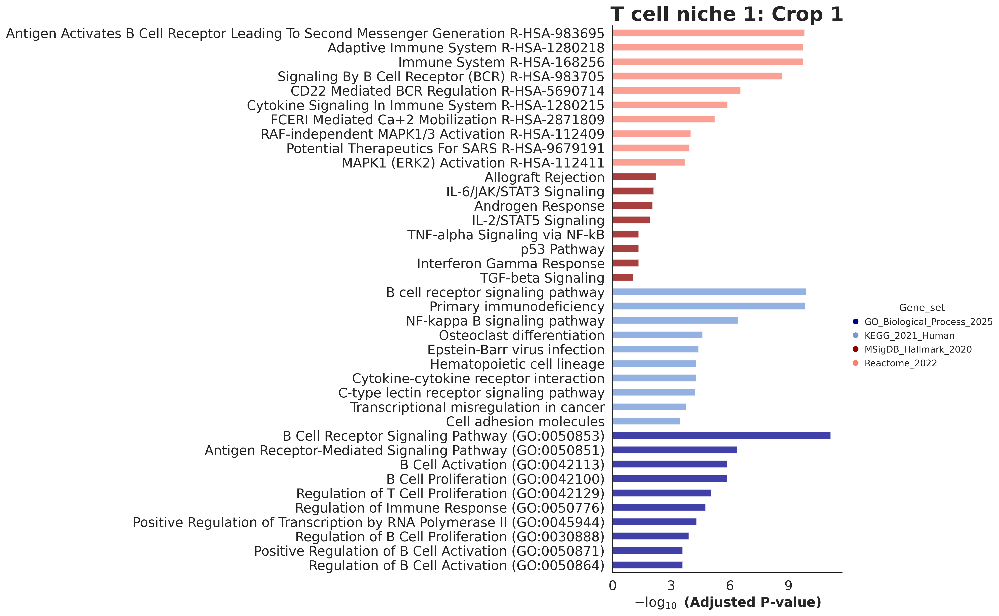

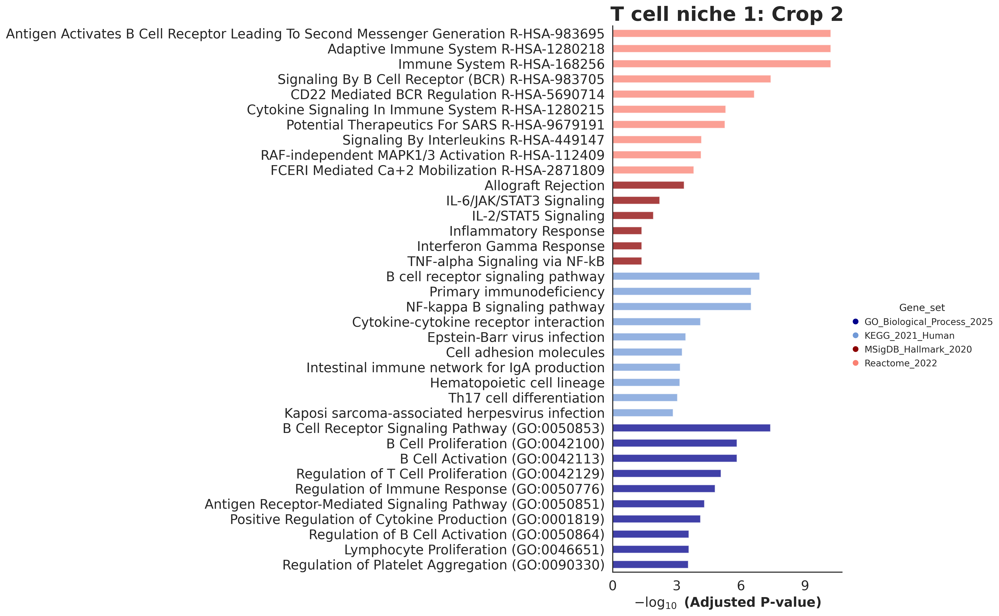

In [178]:
## niche 1
sns.set_theme(style='white')
for enr, dataset in zip([enr11, enr12], ['Crop 1', 'Crop 2']):
    with mpl.rc_context({'figure.dpi': 300}):
        gseapy.barplot(enr.results,
                       title=f"T cell niche 1: {dataset}",
                       cutoff=0.1,
                       column="Adjusted P-value",
                       group='Gene_set', 
                       size=10,
                       top_term=10,
                       figsize=(5,12),
                       color=['darkblue','#7099d7','darkred','salmon'] 
                      )

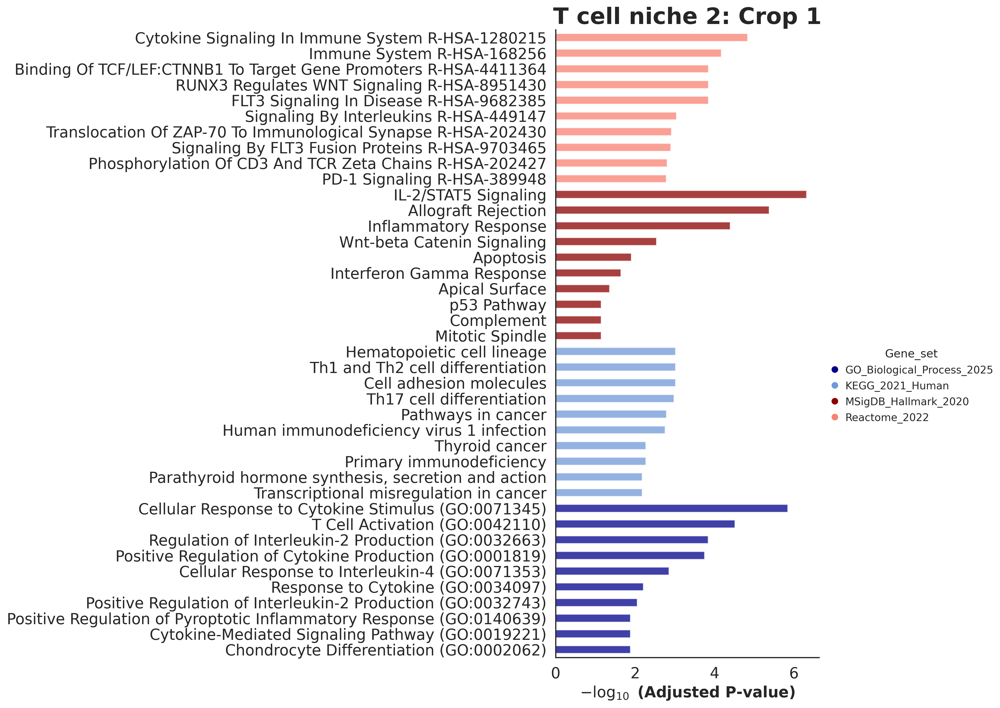

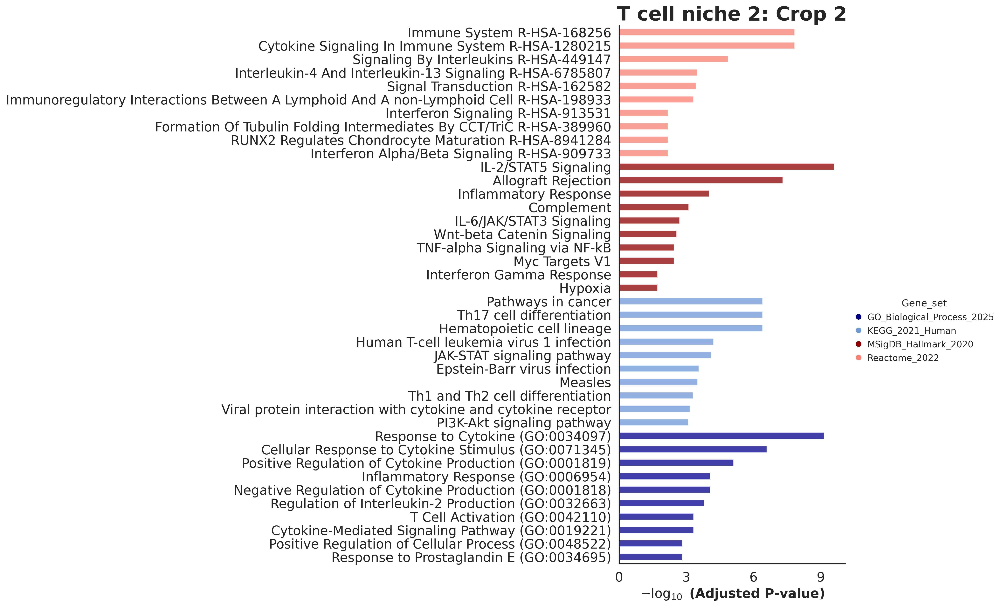

In [179]:
## niche 2
sns.set_theme(style='white')
for enr, dataset in zip([enr21, enr22], ['Crop 1', 'Crop 2']):
    with mpl.rc_context({'figure.dpi': 300}):
        gseapy.barplot(enr.results,
                       title=f"T cell niche 2: {dataset}",
                       cutoff=0.1,
                       column="Adjusted P-value",
                       group='Gene_set', 
                       size=10,
                       top_term=10,
                       figsize=(5,12),
                       color=['darkblue','#7099d7','darkred','salmon'] 
                      )

In [194]:
## representative pathways significant in niche 1 or 2
# niche 1 
sel_terms1 = ['B Cell Receptor Signaling Pathway (GO:0050853)',
              'NF-kappa B signaling pathway',
              'B Cell Activation (GO:0042113)',
              'B Cell Proliferation (GO:0042100)',
              'Regulation of T Cell Proliferation (GO:0042129)',
              'T cell receptor signaling pathway',
              'Lymphocyte Differentiation (GO:0030098)',
              'JAK-STAT signaling pathway']
# niche 2
sel_terms2 = ['IL-2/STAT5 Signaling',
              'Cellular Response to Cytokine Stimulus (GO:0071345)',
              'T Cell Activation (GO:0042110)',
              'Regulation of Interleukin-2 Production (GO:0032663)', 
              'Th1 and Th2 cell differentiation',
              'Th17 cell differentiation',
              'Cellular Response to Interleukin-4 (GO:0071353)']
## for ordering terms
df1_ = enr11.results.loc[enr11.results.Gene_set.isin(['GO_Biological_Process_2025', 'MSigDB_Hallmark_2020', 'KEGG_2021_Human'])]
df2_ = enr21.results.loc[enr21.results.Gene_set.isin(['GO_Biological_Process_2025', 'MSigDB_Hallmark_2020', 'KEGG_2021_Human'])]
df1_ = df1_.loc[df1_.Term.isin(sel_terms1)].sort_values('Adjusted P-value').reset_index(drop=True)
df2_ = df2_.loc[df2_.Term.isin(sel_terms2)].sort_values('Adjusted P-value').reset_index(drop=True)
terms1 = df1_.Term.tolist()
terms2 = df2_.Term.tolist()
    
print(f'Representative pathways: show {len(terms1)} for niche 1 and {len(terms2)} for niche 2.')

Representative pathways: show 8 for niche 1 and 7 for niche 2.


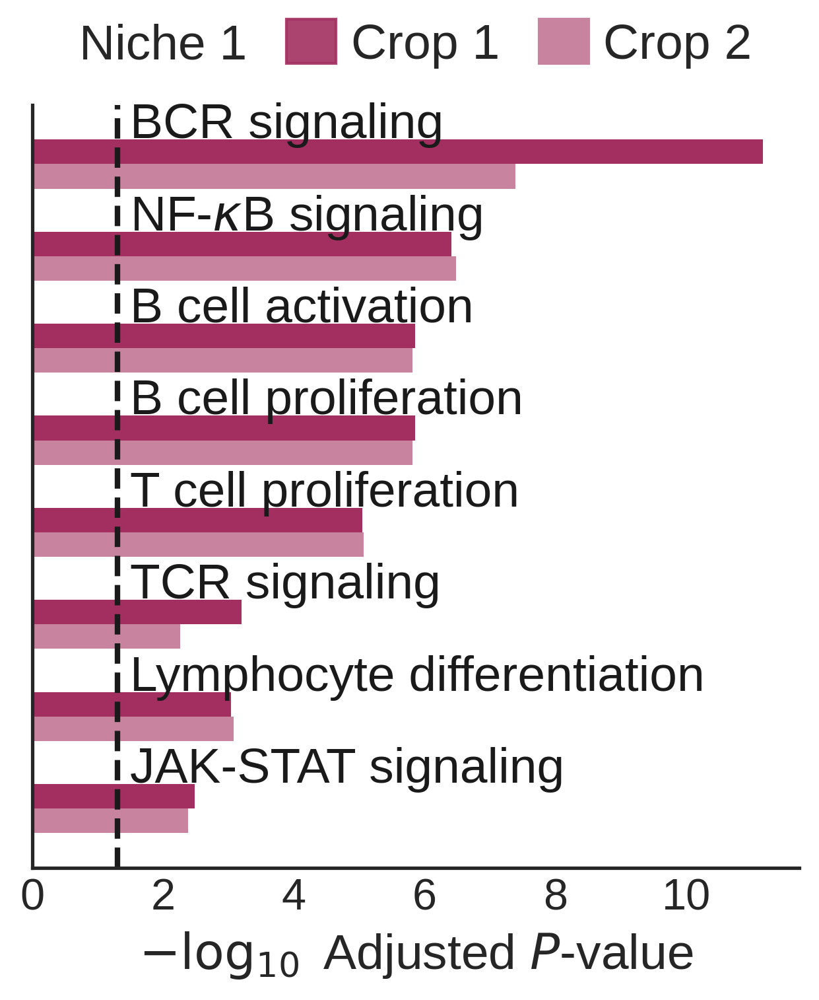

In [195]:
## niche 1
columns = ['Niche 1-1', 'Niche 1-2', 'Niche 2-1', 'Niche 2-2']
comb_df0 = pd.DataFrame(0, index=terms1, columns=columns)
for column, enr in zip(columns, [enr11, enr12, enr21, enr22]):
    df = enr.results.copy()
    df = df.loc[df.Term.isin(terms1)].reset_index(drop=True)
    comb_df0.loc[df.Term, column] = -np.log10(df['Adjusted P-value'].values)
df0 = comb_df0.stack().reset_index(name='score')

data = comb_df0.copy()
yticklabels = ['BCR signaling', 
               r'NF-$\kappa$B signaling',
               'B cell activation', 
               'B cell proliferation',
               'T cell proliferation',
               'TCR signaling',
               'Lymphocyte differentiation',
               'JAK-STAT signaling']

bar_multi = 1.5
x_offset = 1.5
y_multi = 0.3
h = 0.8
title_fs = 18
label_fs = 18
text_fs = 18
tick_fs = 16
lgd_fs = 18
figsize = (5,5)
dpi = 300
colors1 = ['#a32f61', '#c8839e', '#eedae0']

style.use('seaborn-v0_8-white')
fig, ax = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
xranges = np.arange(len(data))*bar_multi
xranges1 = xranges - h/4
xranges2 = xranges + h/4
ax.axvline(-np.log10(0.05), ls='dashed', lw=2., color='k')
bars1 = ax.barh(xranges1, data['Niche 1-1'].values, height=h/2, color=colors1[0], lw=0)
bars2 = ax.barh(xranges2, data['Niche 1-2'].values, height=h/2, color=colors1[1], lw=0)
for i, bar in enumerate(bars1):
    (x,y) = bar.get_xy()
    ax.text(x+x_offset, y-y_multi*h, yticklabels[i], color='k', weight='normal', va='center', fontsize=text_fs)
            
ax.set_yticks([])
ax.set_xticks(np.arange(0,11,2))
ax.set_xticklabels(np.arange(0,11,2), fontsize=tick_fs)
ax.set_xlabel('$- \log_{10}$ Adjusted $P$-value', fontsize=label_fs)
ax.tick_params(axis='both', which='major', labelsize=tick_fs)
ax.invert_yaxis()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_title(title, fontsize=title_fs)
## legend on the top
legend1_patches = [mpatches.Patch(color=colors1[0], label='Crop 1', alpha=0.9),
                   mpatches.Patch(color=colors1[1], label='Crop 2', alpha=1)]
legend1 = ax.legend(handles=legend1_patches, loc='center', bbox_to_anchor=(0.5,1.08), ncol=2, 
                    columnspacing=0.8, handletextpad=0.3,
                    title='Niche 1', alignment='left', fontsize=lgd_fs, title_fontsize=lgd_fs)
legend_title_left(legend1)

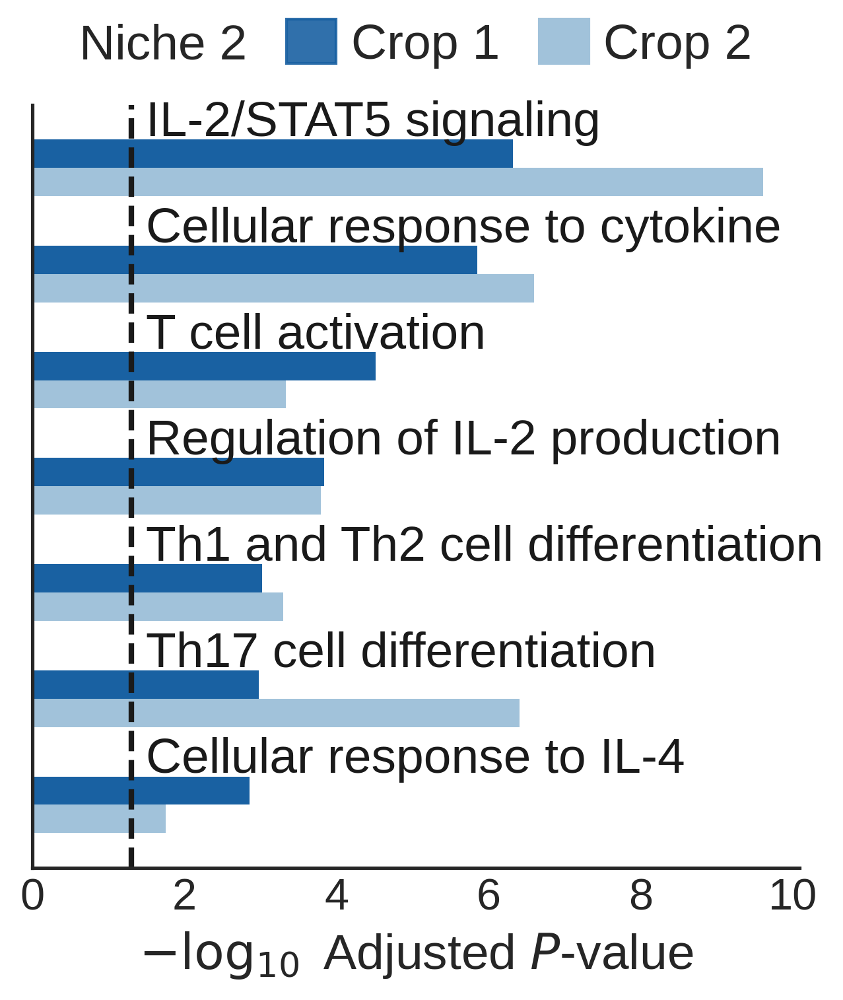

In [196]:
## niche 2
columns = ['Niche 1-1', 'Niche 1-2', 'Niche 2-1', 'Niche 2-2']
comb_df0 = pd.DataFrame(0, index=terms2, columns=columns)
for column, enr in zip(columns, [enr11, enr12, enr21, enr22]):
    df = enr.results.copy()
    df = df.loc[df.Term.isin(terms2)].reset_index(drop=True)
    comb_df0.loc[df.Term, column] = -np.log10(df['Adjusted P-value'].values)
df0 = comb_df0.stack().reset_index(name='score')

data = comb_df0.copy()
yticklabels = ['IL-2/STAT5 signaling',
              'Cellular response to cytokine',
              'T cell activation',
              'Regulation of IL-2 production',
              'Th1 and Th2 cell differentiation',
              'Th17 cell differentiation',
              'Cellular response to IL-4']

bar_multi = 1.5
x_offset = 1.5
y_multi = 0.3
h = 0.8
title_fs = 18
label_fs = 18
text_fs = 18
tick_fs = 16
lgd_fs = 18
figsize = (5,5)
dpi = 300
colors2 = ['#1961a2', '#a1c2da', '#d0e3ee']

style.use('seaborn-v0_8-white')
fig, ax = plt.subplots(1, 1, figsize=figsize, dpi=dpi)
xranges = np.arange(len(data))*bar_multi
xranges1 = xranges - h/4
xranges2 = xranges + h/4
ax.axvline(-np.log10(0.05), ls='dashed', lw=2., color='k')
bars1 = ax.barh(xranges1, data['Niche 2-1'].values, height=h/2, color=colors2[0], lw=0)
bars2 = ax.barh(xranges2, data['Niche 2-2'].values, height=h/2, color=colors2[1], lw=0)
for i, bar in enumerate(bars1):
    (x,y) = bar.get_xy()
    ax.text(x+x_offset, y-y_multi*h, yticklabels[i], color='k', weight='normal', va='center', fontsize=text_fs)
            
ax.set_yticks([])
ax.set_xticks(np.arange(0,11,2))
ax.set_xticklabels(np.arange(0,11,2), fontsize=tick_fs)
ax.set_xlabel('$- \log_{10}$ Adjusted $P$-value', fontsize=label_fs)
ax.tick_params(axis='both', which='major', labelsize=tick_fs)
ax.invert_yaxis()
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_title(title, fontsize=title_fs)
## legend on the top
legend1_patches = [mpatches.Patch(color=colors2[0], label='Crop 1', alpha=0.9),
                   mpatches.Patch(color=colors2[1], label='Crop 2', alpha=1)]
legend1 = ax.legend(handles=legend1_patches, loc='center', bbox_to_anchor=(0.5,1.08), ncol=2, 
                    columnspacing=0.8, handletextpad=0.3,
                    title='Niche 2', alignment='left', fontsize=lgd_fs, title_fontsize=lgd_fs)
legend_title_left(legend1)

## Sub cell type enrichment
Enrichment of subtypes of the target cell type within B cell niche 1 or 2 on Xenium two crops.

In [198]:
## compute enrichment fold
subcts = ['T_CD4+_TfH_GC', 'T_TfR', 'T_CD8+_cytotoxic', 'T_CD4+', 'T_TIM3+', 'T_Treg']
sub11 = sub_ct_enrich(1, meta1['score_df'].copy(), subcts, [0.5,0.75,0.9,0.95], 0.9)
sub12 = sub_ct_enrich(1, meta2['score_df'].copy(), subcts, [0.5,0.75,0.9,0.95], 0.9)
sub21 = sub_ct_enrich(2, meta1['score_df'].copy(), subcts, [0.5,0.75,0.9,0.95], 0.9)
sub22 = sub_ct_enrich(4, meta2['score_df'].copy(), subcts, [0.5,0.75,0.9,0.95], 0.9)

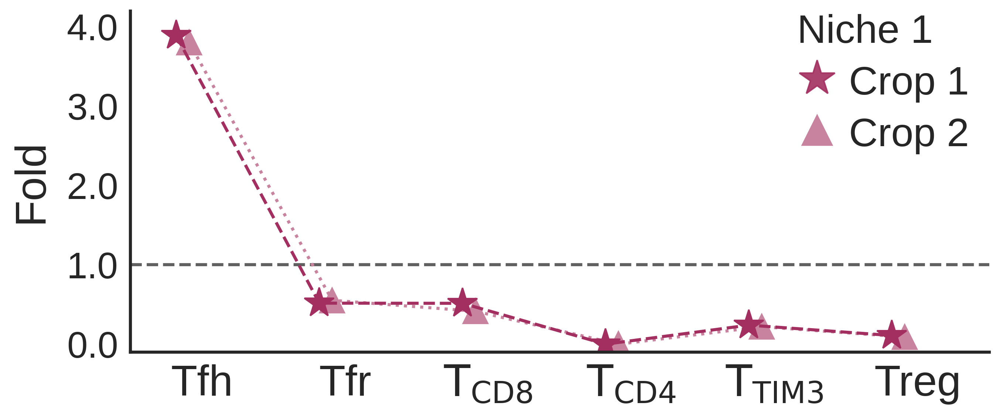

In [205]:
## niche 1
xranges = np.arange(len(subcts))
offset = 0.3
xranges11 = xranges - offset * 2 * offset
xranges12 = xranges - offset * 1 * offset
xranges21 = xranges + offset * 1 * offset
xranges22 = xranges + offset * 2 * offset
col = 'fold_09'
y11 = sub11.loc[subcts][col].values
y12 = sub12.loc[subcts][col].values
y21 = sub21.loc[subcts][col].values
y22 = sub22.loc[subcts][col].values
colors1 = ['#a32f61', '#c8839e']
colors2 = ['#1961a2', '#a1c2da']
markers = ['*', '^']

ms_ = [20, 16]
lw = 2
label_fs = 28
tick_fs = 24
lgd_fs = 26
ymax = np.max([np.max(y11), np.max(y12), np.max(y21), np.max(y22)])

style.use('seaborn-v0_8-white')
fig, ax = plt.subplots(1, 1, figsize=(10,4), dpi=300)
ax.axhline(1, ls='dashed', lw=lw, color='#606060')
ax.plot(xranges12, y12, marker=markers[1], ms=ms_[1], ls='dotted', lw=lw, color=colors1[1], label='Crop 1')
ax.plot(xranges11, y11, marker=markers[0], ms=ms_[0], ls='dashed', lw=lw, color=colors1[0], label='Crop 2')

ax.set_xticks(xranges)
ax.set_xticklabels([subct_name_dict[k] for k in subcts], fontsize=label_fs, ha='center')
ax.set_xlim([-0.5, 5.5])
ax.set_ylim([-0.1, 4.2])
ax.set_yticks(np.arange(0,4.1,1))
ax.set_yticklabels(np.arange(0,4.1,1), fontsize=tick_fs)
ax.set_ylabel('Fold', fontsize=label_fs, labelpad=10)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
for side in ['bottom', 'left']:
    ax.spines[side].set_linewidth(2)
ax.tick_params(axis='both', pad=8)

ms_scale = 1.2
legend1_patches = [mlines.Line2D([0], [0], marker=markers[0], ms=ms_[0]*ms_scale, color=colors1[0], lw=0, label='Crop 1', alpha=0.9),
                   mlines.Line2D([0], [0], marker=markers[1], ms=ms_[1]*ms_scale, color=colors1[1], lw=0, label='Crop 2', alpha=1)]
legend1 = ax.legend(handles=legend1_patches, loc='upper right', bbox_to_anchor=(1.0,1.05), handletextpad=0.3, labelspacing=0.3,
                    title='Niche 1', alignment='left', fontsize=lgd_fs, title_fontsize=lgd_fs)

plt.subplots_adjust(hspace=0.1)

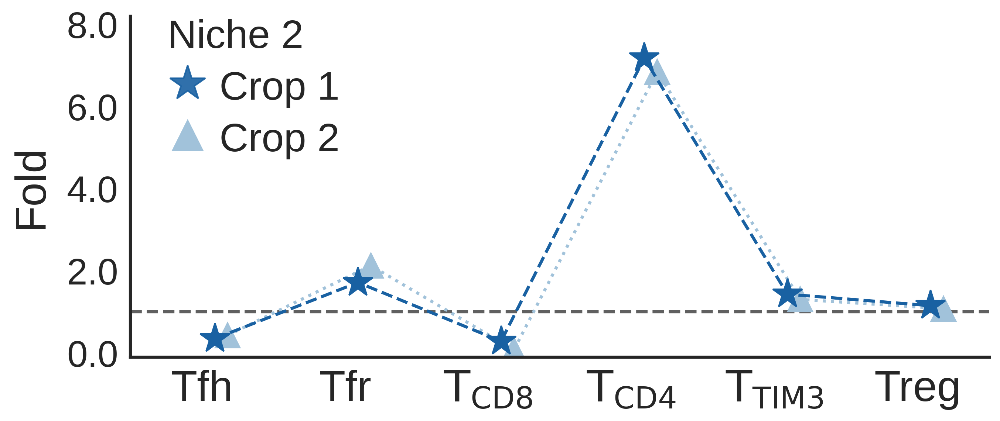

In [206]:
## niche 2
xranges = np.arange(len(subcts))
offset = 0.3
xranges11 = xranges - offset * 2 * offset
xranges12 = xranges - offset * 1 * offset
xranges21 = xranges + offset * 1 * offset
xranges22 = xranges + offset * 2 * offset
col = 'fold_09'
y11 = sub11.loc[subcts][col].values
y12 = sub12.loc[subcts][col].values
y21 = sub21.loc[subcts][col].values
y22 = sub22.loc[subcts][col].values
colors1 = ['#a32f61', '#c8839e']
colors2 = ['#1961a2', '#a1c2da']
markers = ['*', '^']

ms_ = [20, 16]
lw = 2
label_fs = 28
tick_fs = 24
lgd_fs = 26
ymax = np.max([np.max(y11), np.max(y12), np.max(y21), np.max(y22)])

style.use('seaborn-v0_8-white')
fig, ax = plt.subplots(1, 1, figsize=(10,4), dpi=300)
ax.axhline(1, ls='dashed', lw=lw, color='#606060')
ax.plot(xranges22, y22, marker=markers[1], ms=ms_[1], ls='dotted', lw=lw, color=colors2[1], label='Crop 1')
ax.plot(xranges21, y21, marker=markers[0], ms=ms_[0], ls='dashed', lw=lw, color=colors2[0], label='Crop 2')

ax.set_xticks(xranges)
ax.set_xticklabels([subct_name_dict[k] for k in subcts], fontsize=label_fs, ha='center')
ax.set_xlim([-0.5, 5.5])
ax.set_ylim([-0.1, 8.2])
ax.set_yticks(np.arange(0,8.2,2))
ax.set_yticklabels(np.arange(0,8.2,2), fontsize=tick_fs)
ax.set_ylabel('Fold', fontsize=label_fs, labelpad=10)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
for side in ['bottom', 'left']:
    ax.spines[side].set_linewidth(2)
ax.tick_params(axis='both', pad=8)

ms_scale = 1.2
legend1_patches = [mlines.Line2D([0], [0], marker=markers[0], ms=ms_[0]*ms_scale, color=colors2[0], lw=0, label='Crop 1', alpha=0.9),
                   mlines.Line2D([0], [0], marker=markers[1], ms=ms_[1]*ms_scale, color=colors2[1], lw=0, label='Crop 2', alpha=1)]
legend1 = ax.legend(handles=legend1_patches, loc='upper left', bbox_to_anchor=(0.02,1.05), handletextpad=0.3, labelspacing=0.3,
                    title='Niche 2', alignment='left', fontsize=lgd_fs, title_fontsize=lgd_fs)

plt.subplots_adjust(hspace=0.1)